## Reading Data

In [2]:
from tqdm import tqdm
import torch
from torch import nn
from torch.nn import functional as F
from torch.nn.modules.module import Module
from sklearn.preprocessing import OneHotEncoder

/Users/mohamedr/opt/anaconda3/envs/xai/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
from read_data import read_save
read_save()

In [4]:
from read_data import tr_test_split
train_data_files, test_data_files = tr_test_split(0.5)

## Window size : 500. Classification of Control vs MCI

In [5]:
from read_data import build_data
train_X, train_graphs, train_y = build_data(train_data_files, size=500, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=500, cal_conn="corr", bands=True)

100%|███████████████████████████████████████████| 84/84 [11:26<00:00,  8.17s/it]


In [6]:
from read_data import stack_arrays
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

In [7]:
from process import label2skip, uniform, standardize_data, get_lap
train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 2911/2911 [00:16<00:00, 173.84it/s]


Here are the performances matrices of the prediction of the 5 used models, The point here aim to study the stability of the models in training

In [8]:
from sklearn.preprocessing import OneHotEncoder
from process import data_loader
from train import trainer

DEVICE = torch.device("cpu")
BATCH_SIZE = 200

encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:23<00:00,  1.19s/it]


In [9]:
from evaluate import cal_accuracy

print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[3010    0]
 [   0 1212]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1936    0]
 [   0  975]]


In [10]:
from explain import build_maps
import numpy as np
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 4222/4222 [00:30<00:00, 139.83it/s]


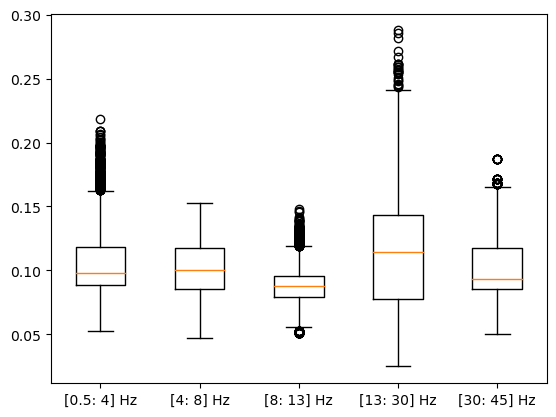

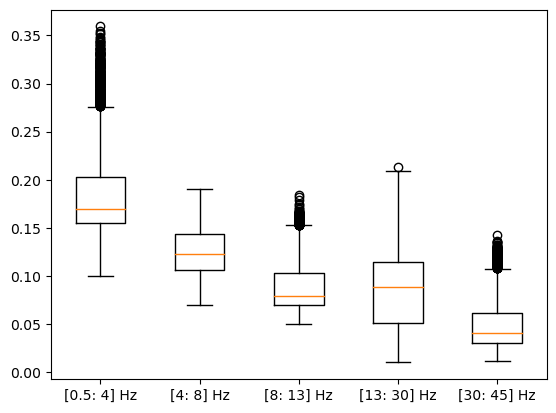

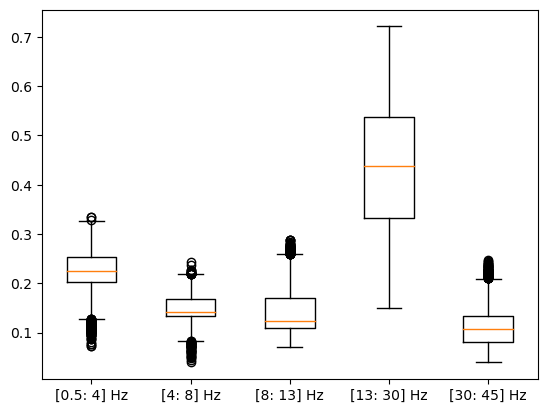

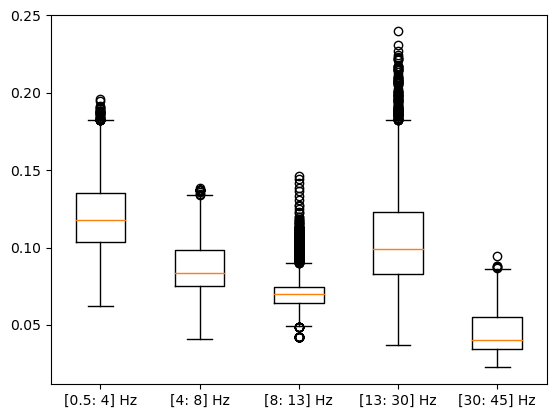

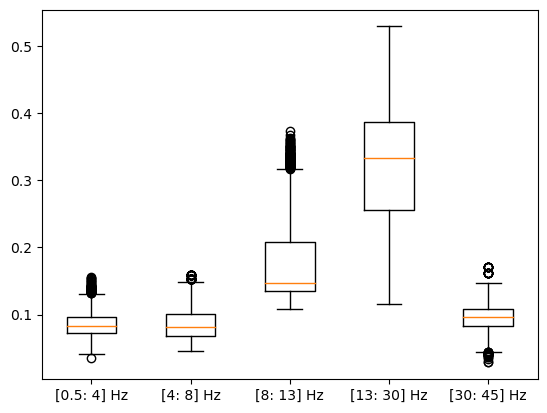

...

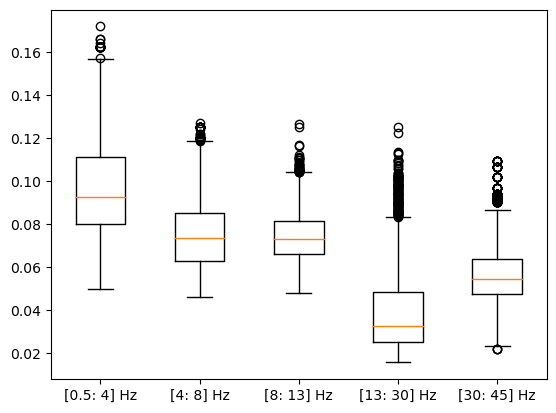

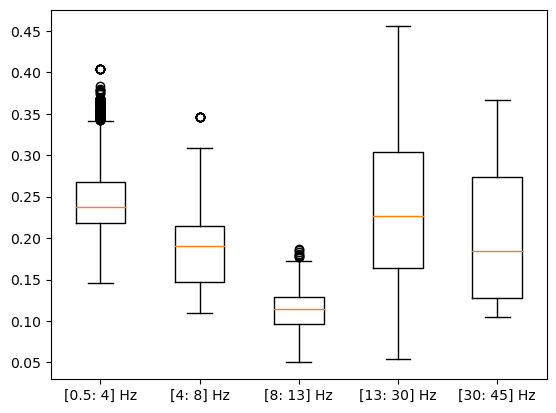

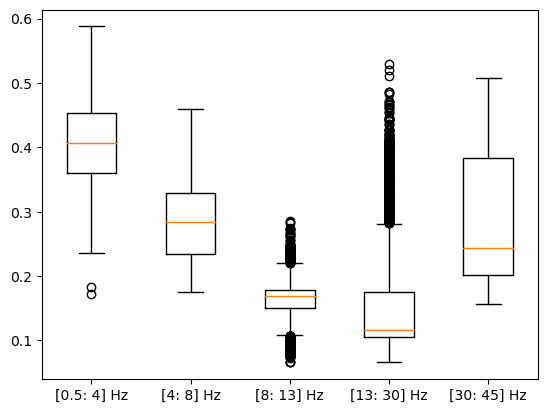

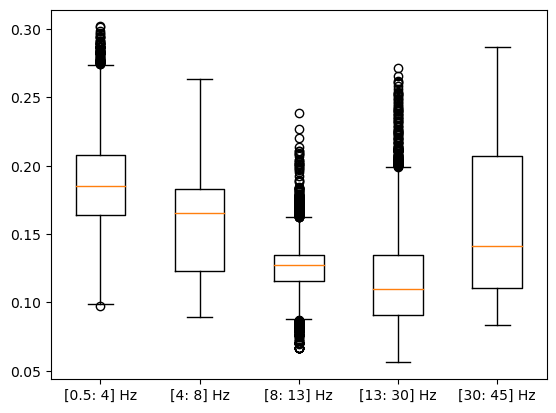

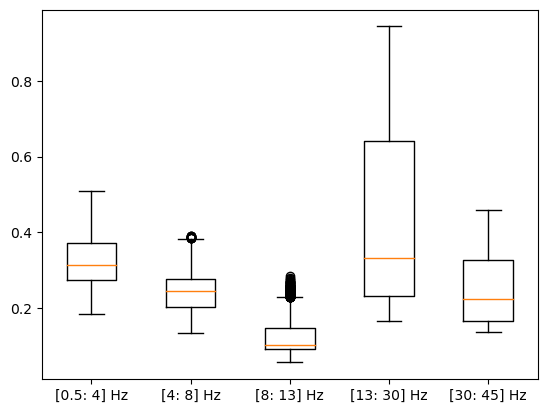

In [11]:
import matplotlib.pyplot as plt
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

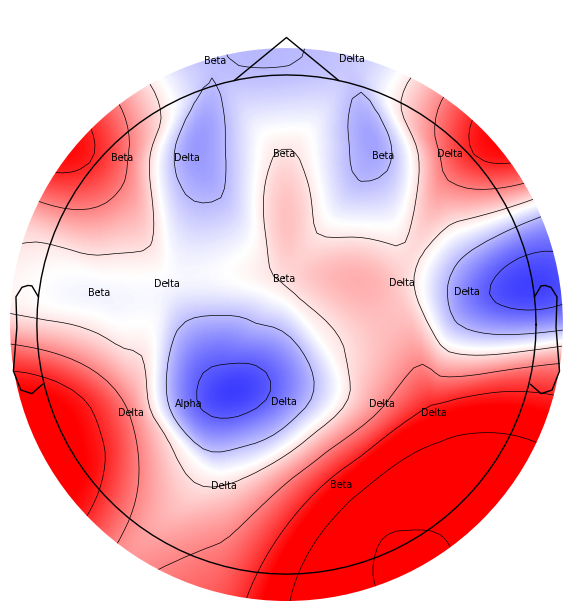

In [12]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [13]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

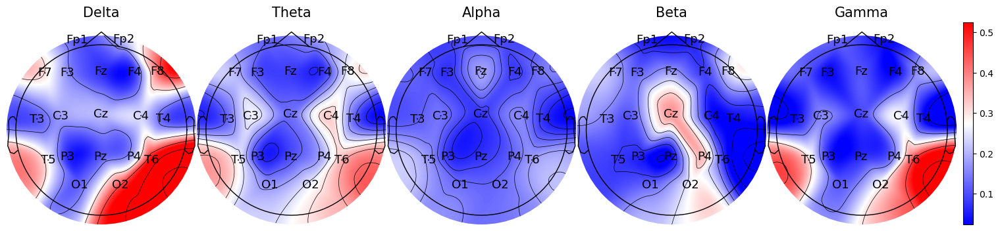

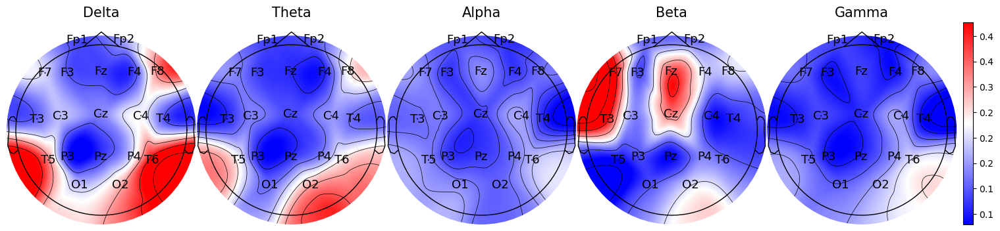

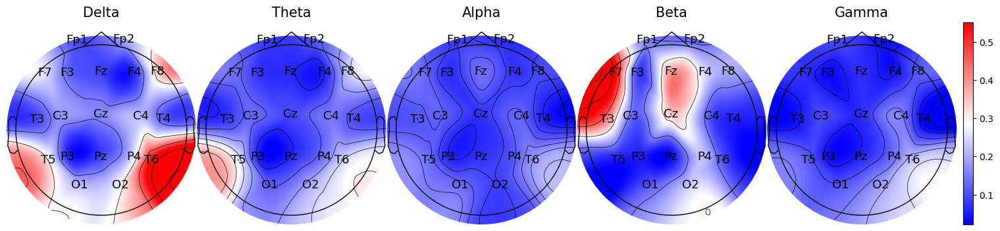

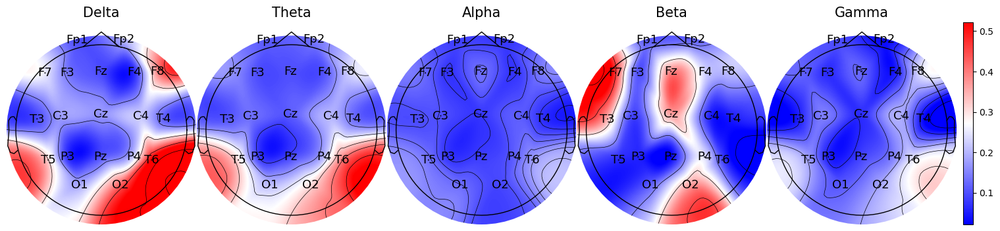

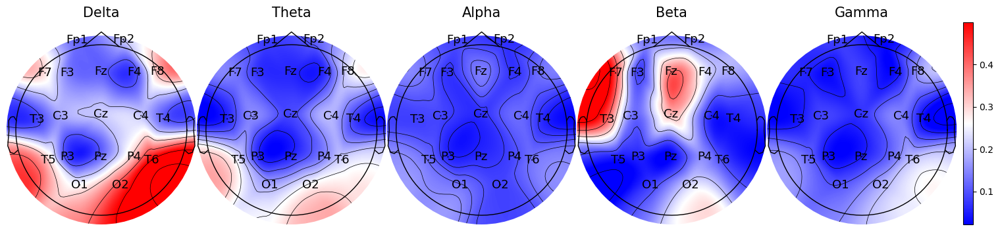

In [14]:
from plot import plot_frequency_bands_graphs
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

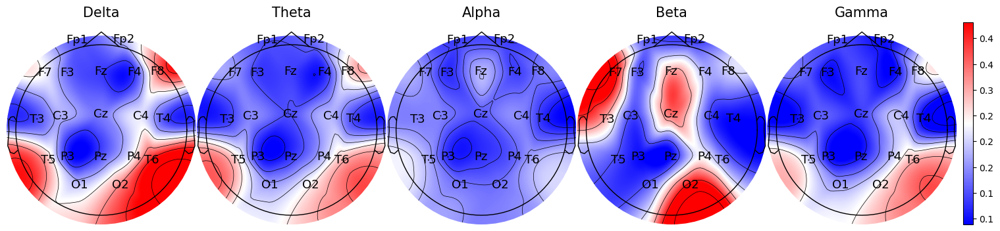

In [15]:
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="500_avg")

In [16]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 4222/4222 [00:31<00:00, 135.00it/s]


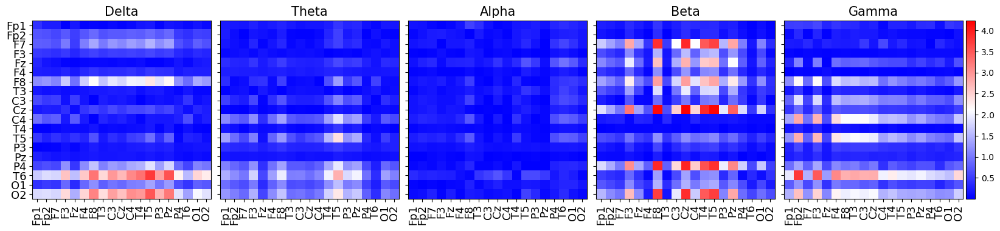

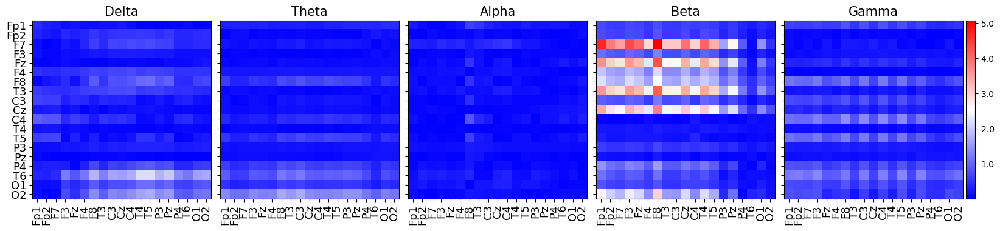

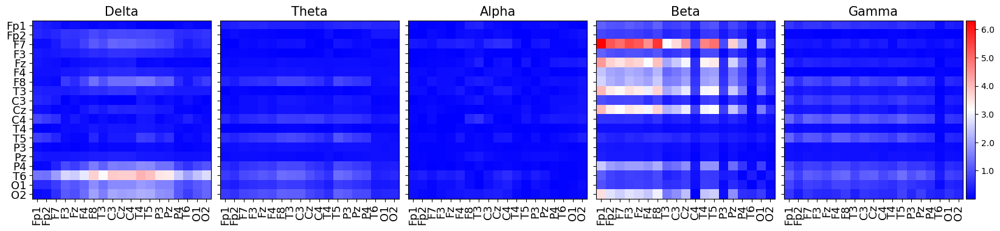

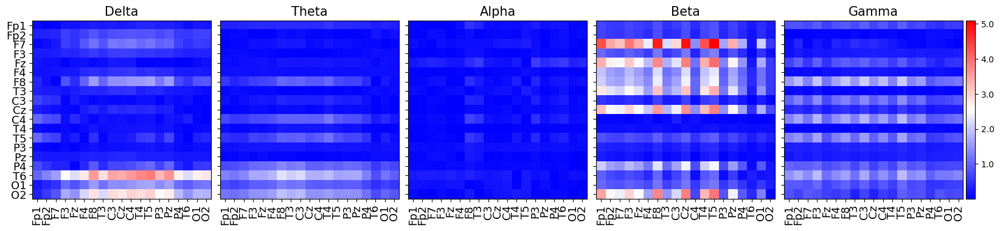

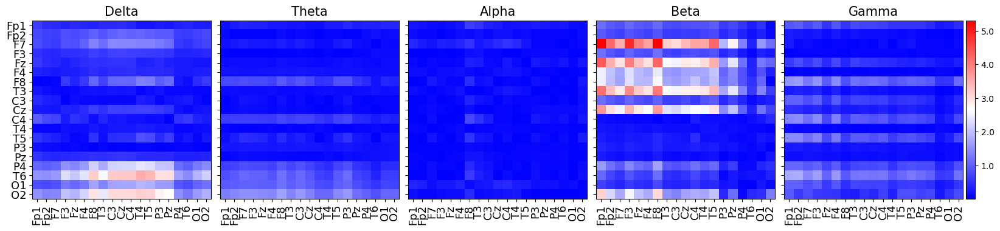

In [17]:
from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="500_"+str(rand_idx))

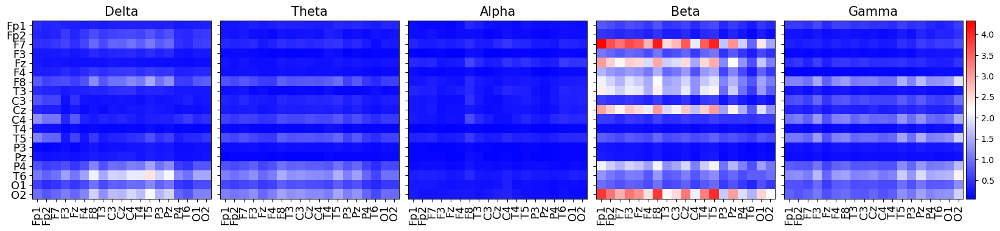

In [18]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="500_avg")

## Window size : 300. Classification of Control vs MCI

In [19]:
train_X, train_graphs, train_y = build_data(train_data_files, size=300, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=300, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 4894/4894 [00:27<00:00, 175.23it/s]


In [20]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()
train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)
model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:44<00:00,  2.24s/it]


In [21]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[5074    0]
 [   0 2023]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[3268    0]
 [   0 1626]]


In [26]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 7097/7097 [00:46<00:00, 151.38it/s]


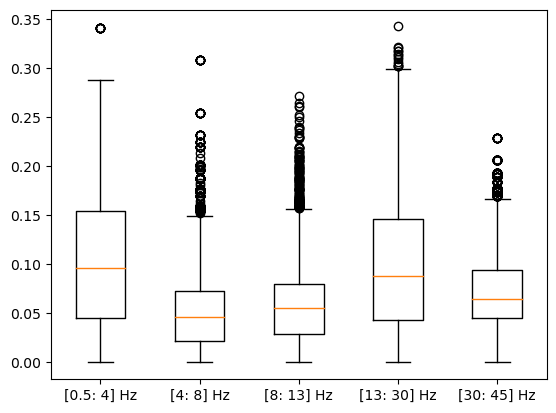

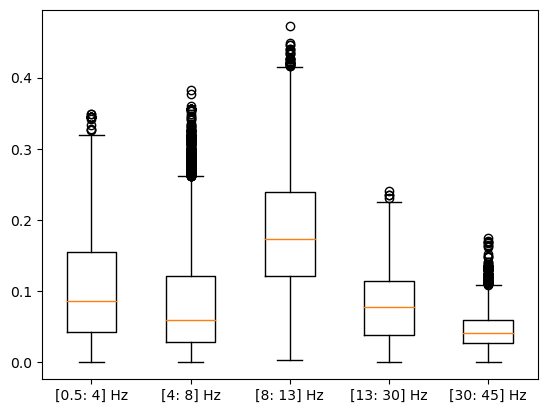

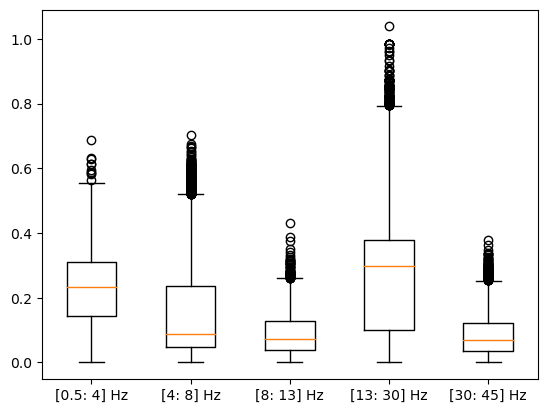

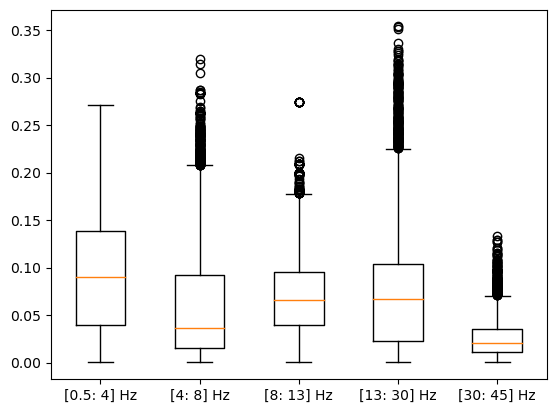

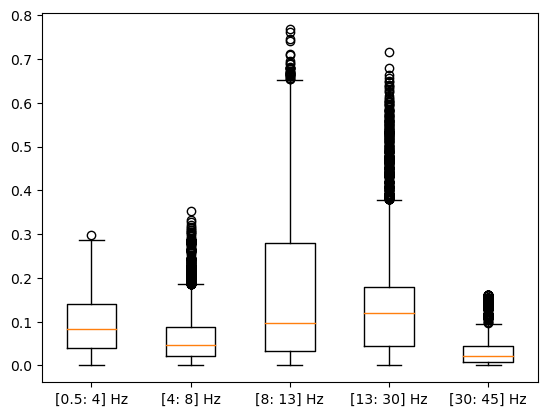

...

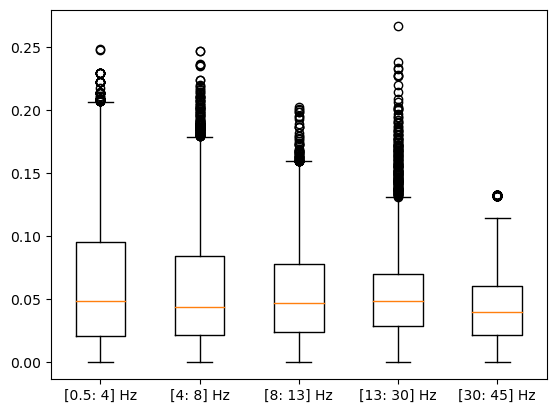

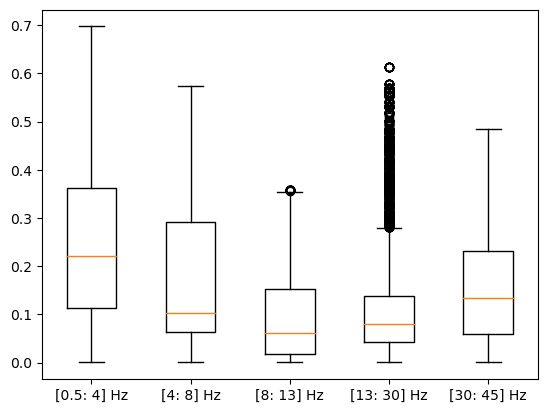

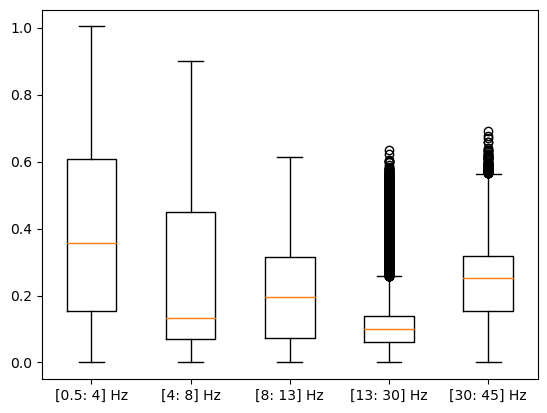

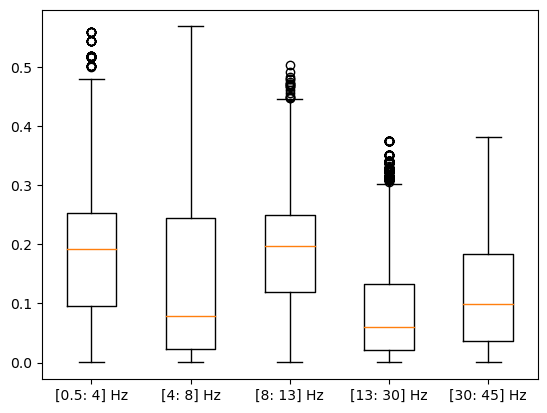

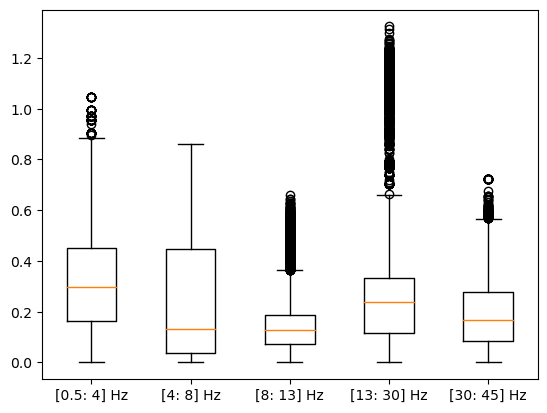

In [27]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances[:, i, 6, :])
    ax.set_xticklabels(xticks)

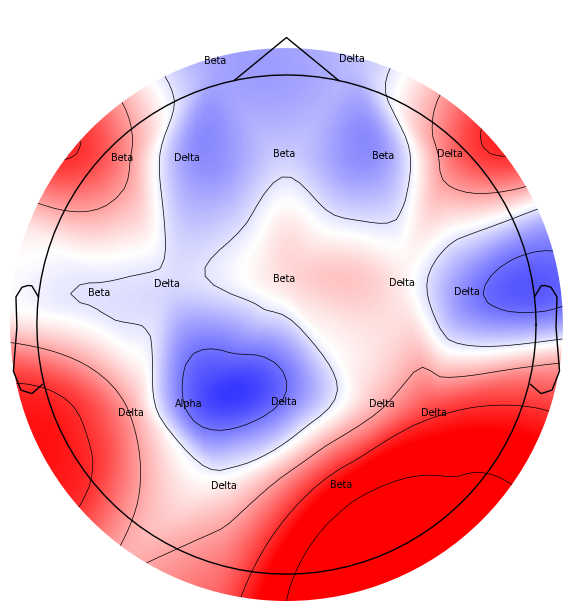

In [28]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [29]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

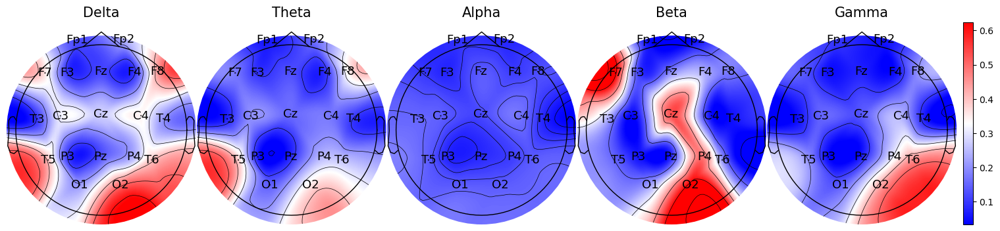

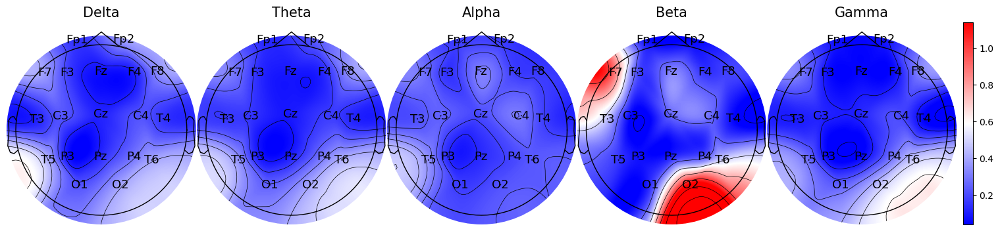

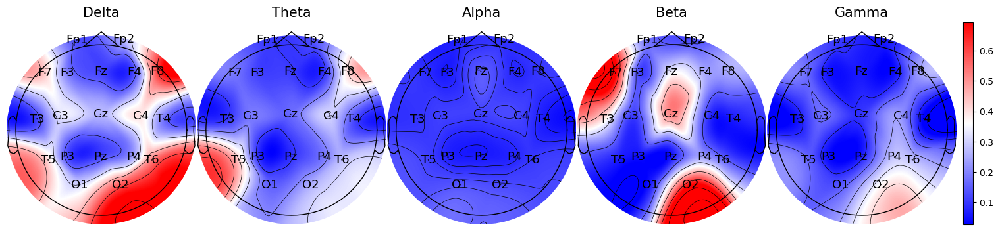

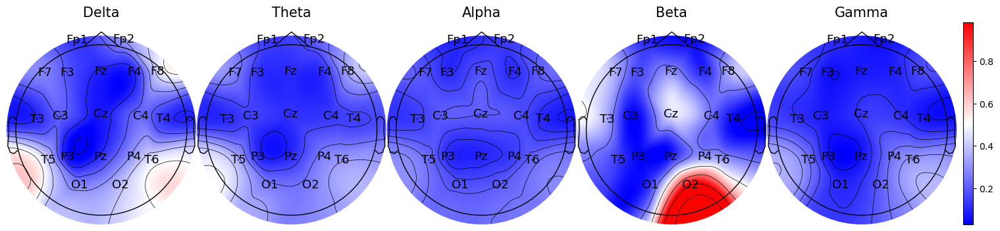

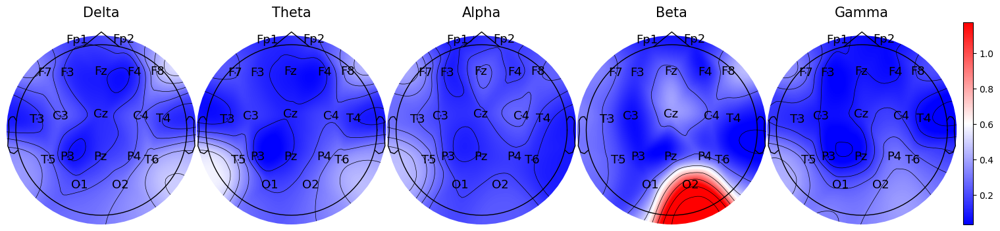

In [30]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

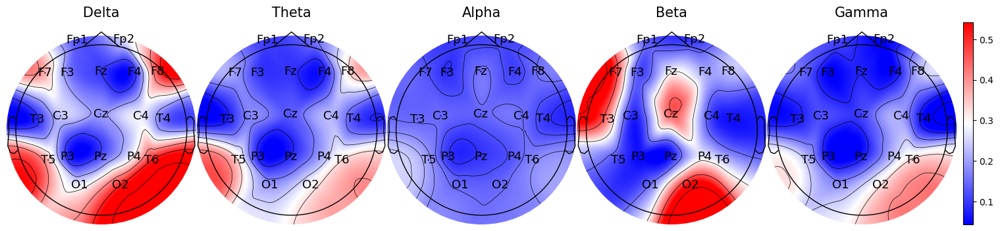

In [31]:
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="300_avg")

In [32]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 7097/7097 [00:50<00:00, 140.74it/s]


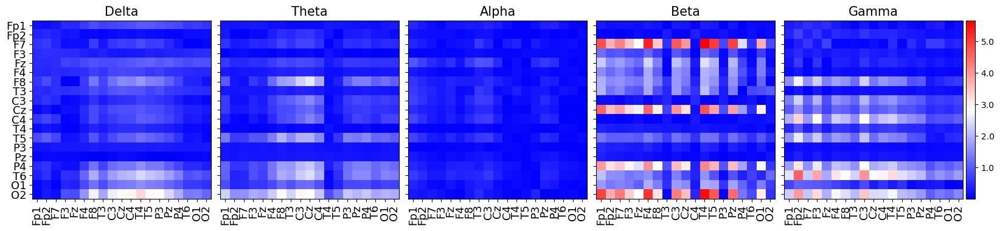

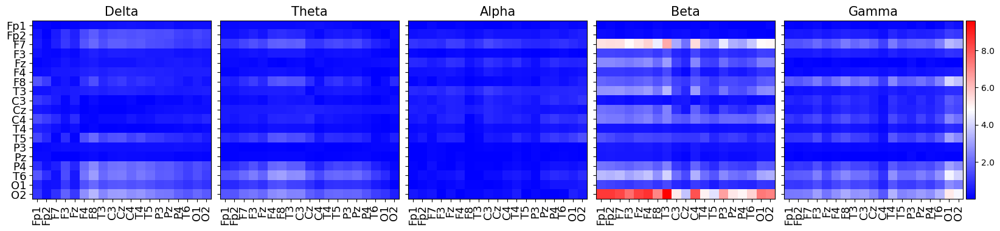

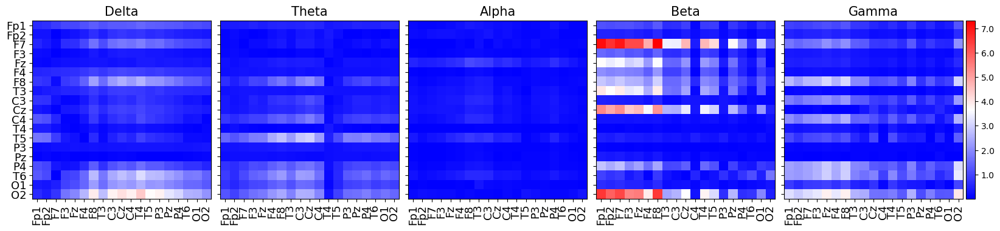

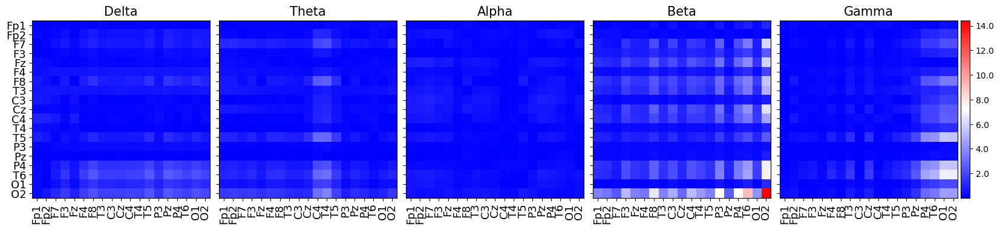

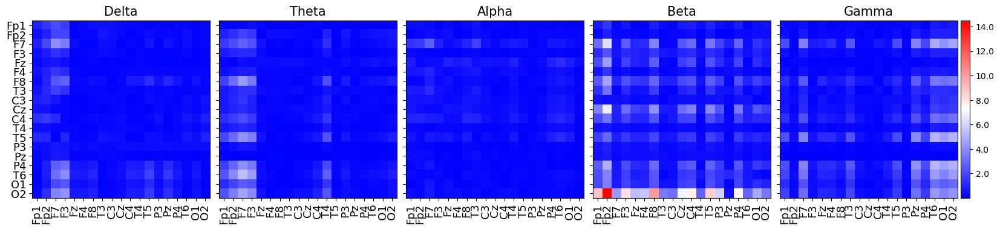

In [33]:
from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="300_"+str(rand_idx))

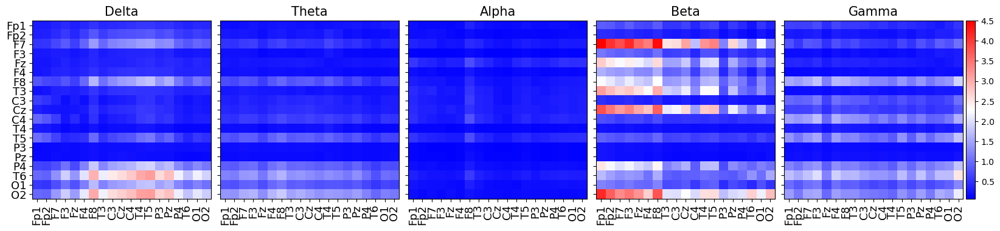

In [34]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="300_avg")

## Window size : 1000. Classification of Control vs MCI

In [35]:
train_X, train_graphs, train_y = build_data(train_data_files, size=1000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=1000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 1440/1440 [00:08<00:00, 171.74it/s]


In [36]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:10<00:00,  1.84it/s]


In [37]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1486    0]
 [   0  602]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[954   0]
 [  0 486]]


In [38]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 2088/2088 [00:14<00:00, 148.95it/s]


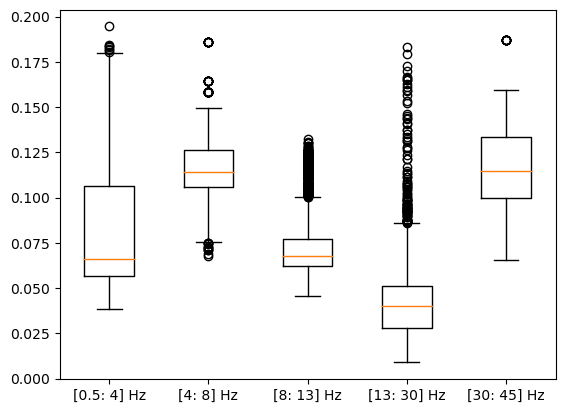

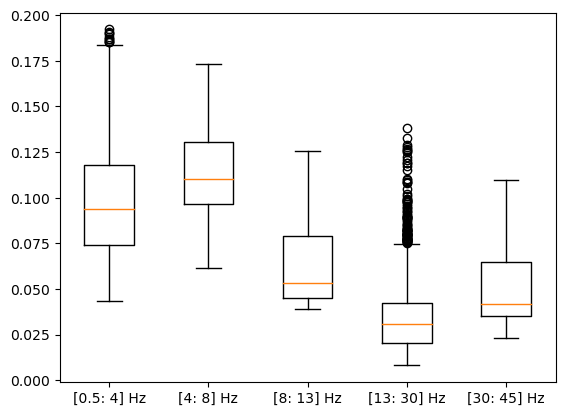

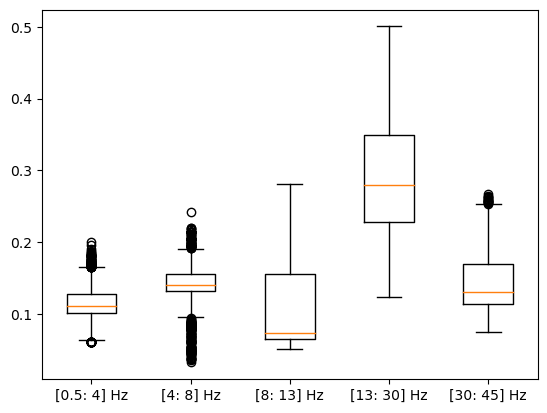

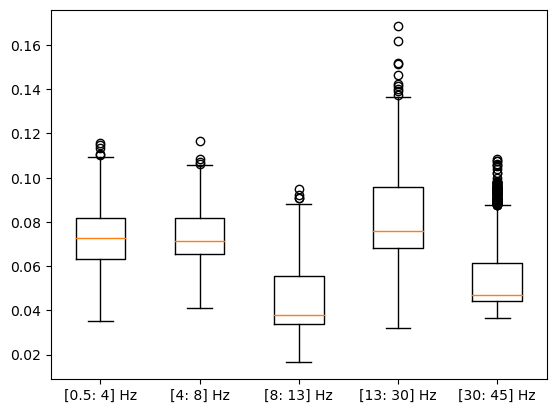

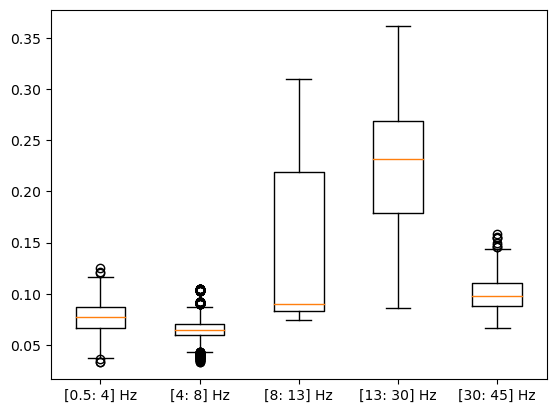

...

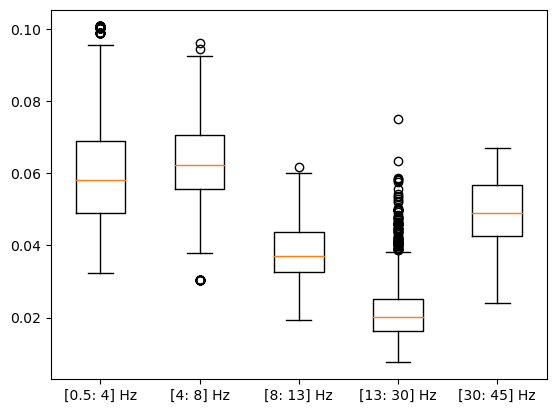

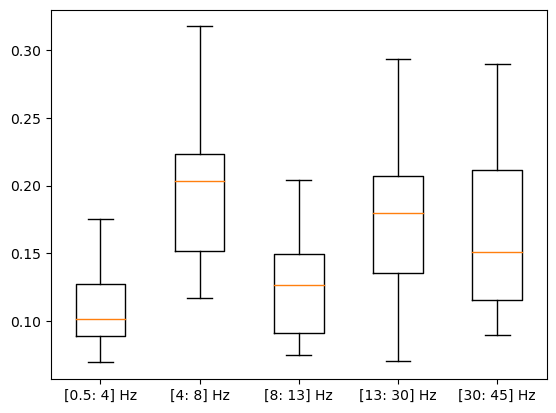

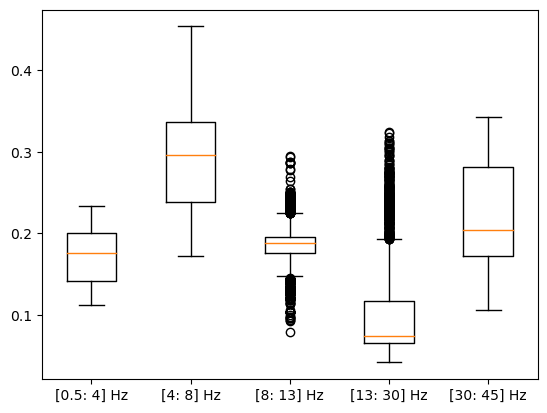

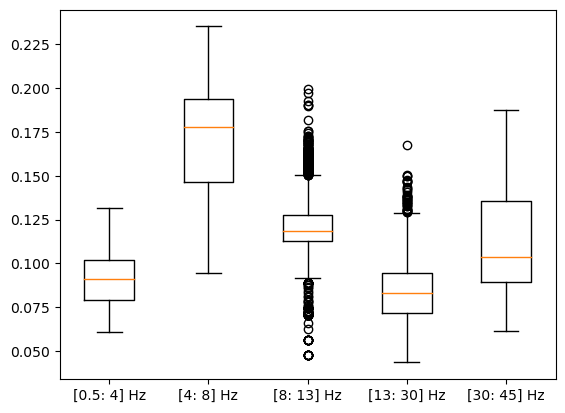

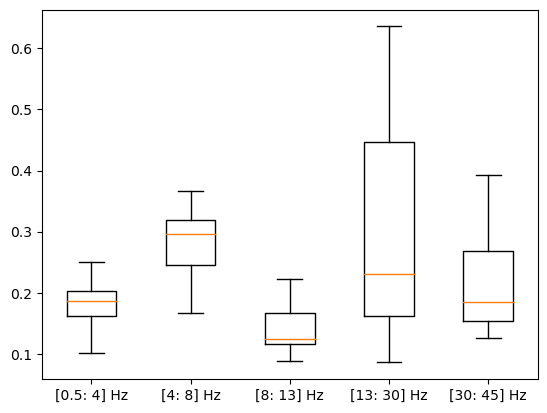

In [39]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

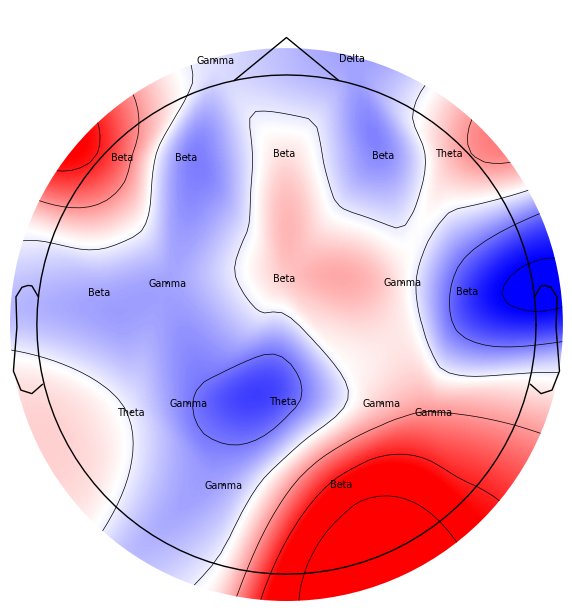

In [122]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [41]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

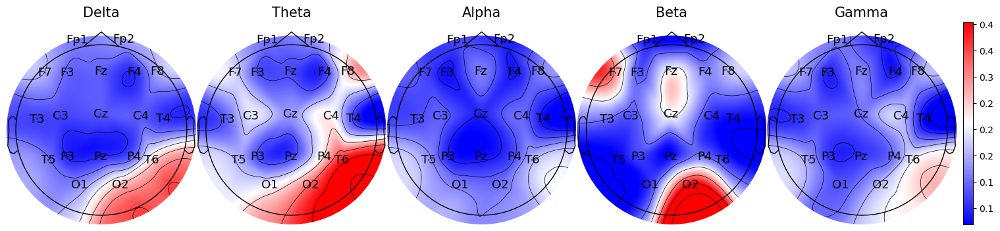

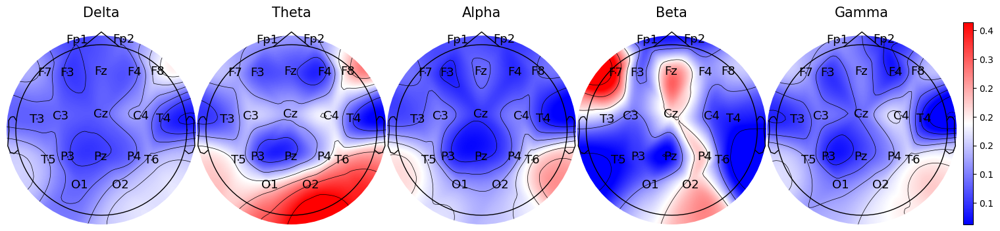

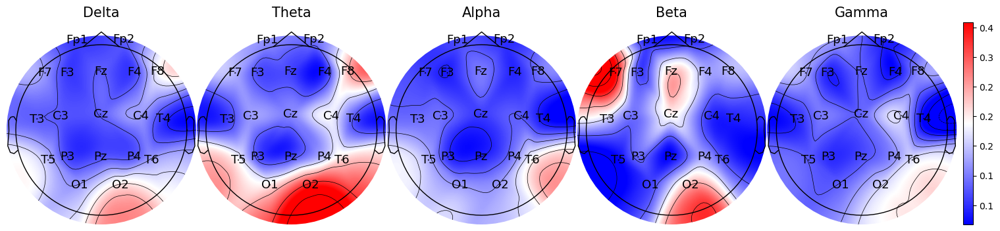

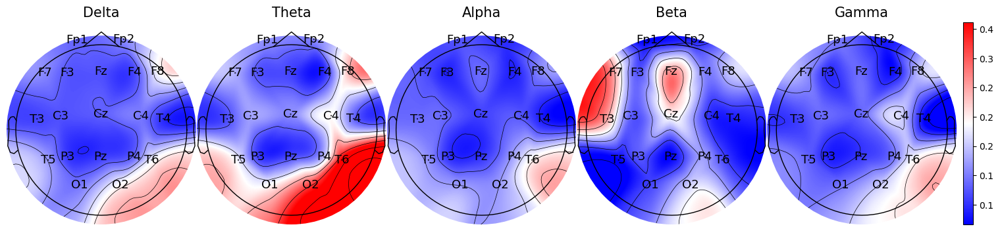

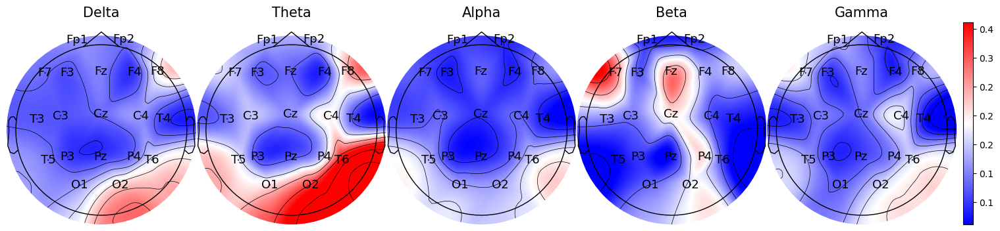

In [42]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="1000_"+str(rand_idx))

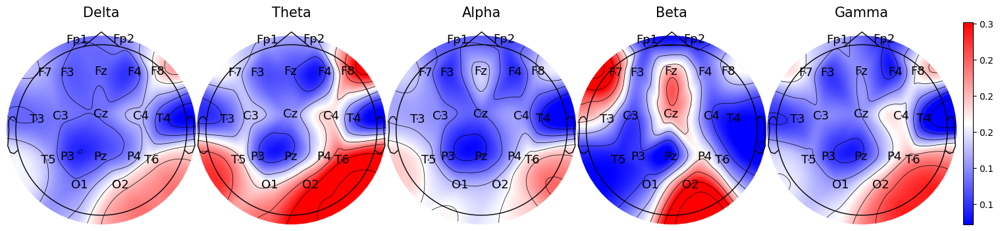

In [43]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="1000_avg")

In [44]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 2088/2088 [00:14<00:00, 143.42it/s]


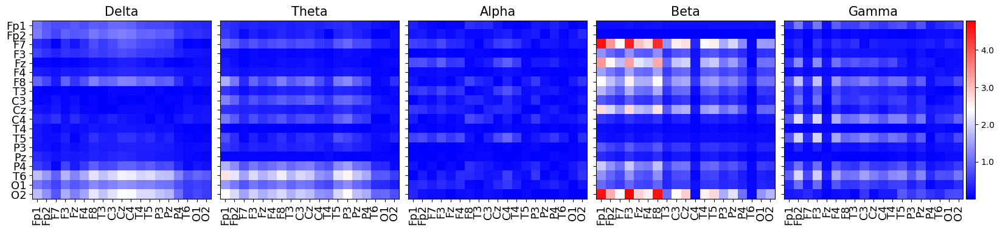

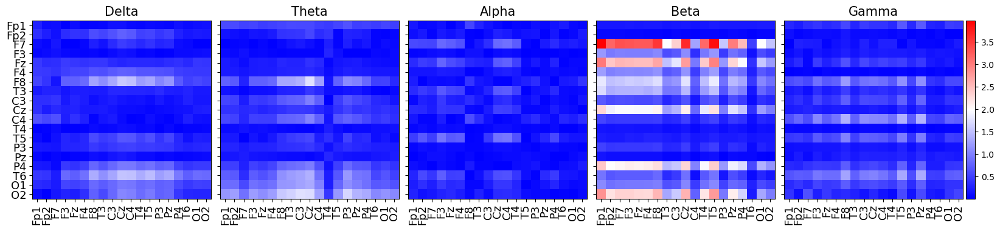

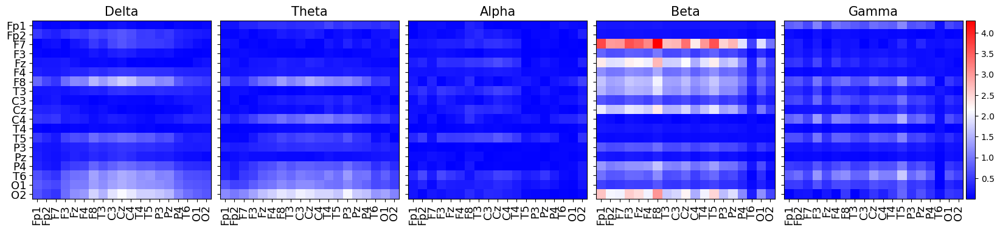

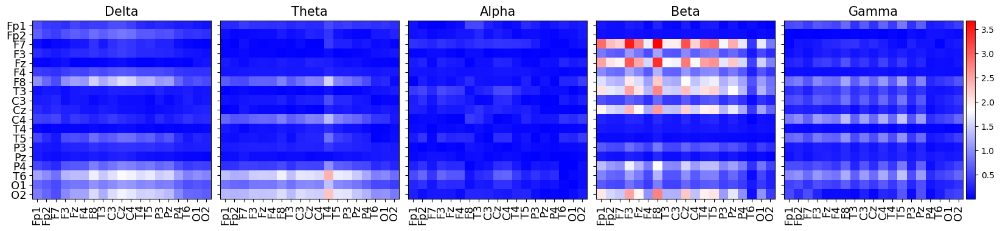

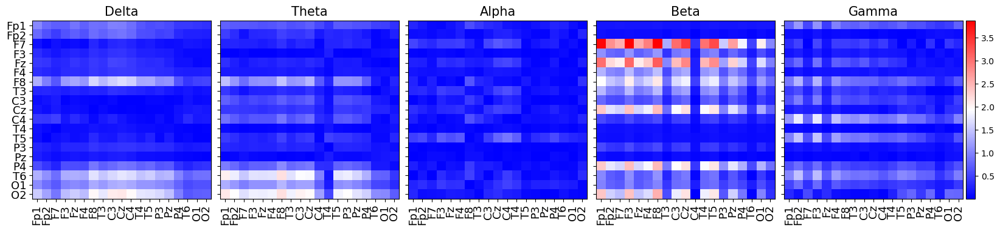

In [45]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="1000_"+str(rand_idx))

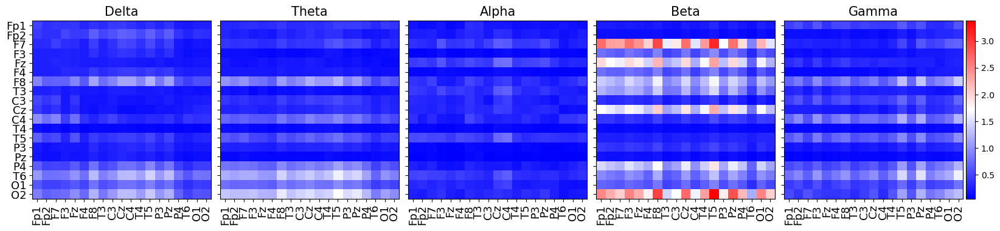

In [46]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="1000_avg")

## Window size : 800. Classification of Control vs MCI

In [64]:
train_X, train_graphs, train_y = build_data(train_data_files, size=800, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=800, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 1802/1802 [00:10<00:00, 172.21it/s]


In [65]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:12<00:00,  1.59it/s]


In [66]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1860    0]
 [   0  754]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1194    0]
 [   0  608]]


In [67]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 2614/2614 [00:16<00:00, 155.01it/s]


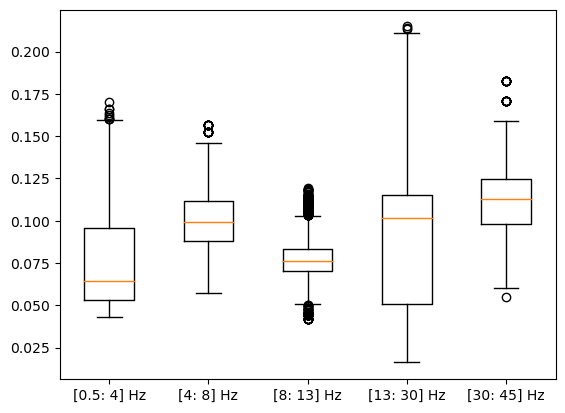

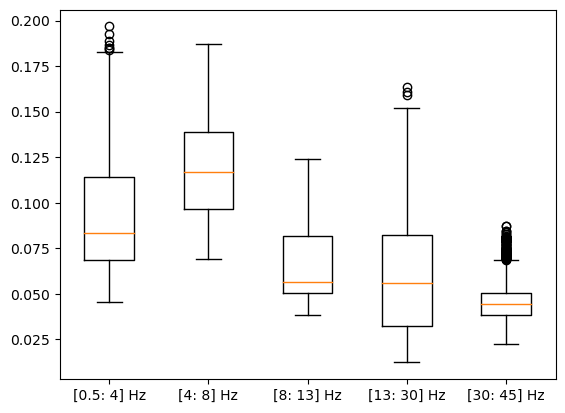

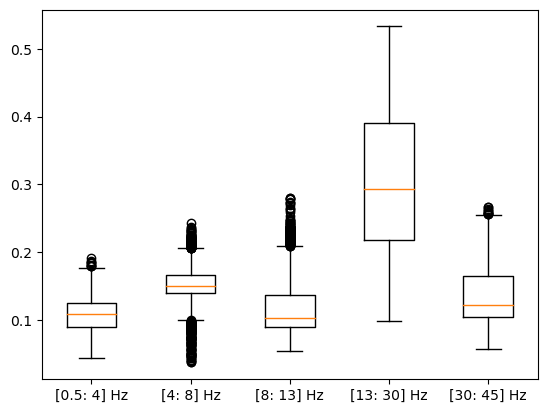

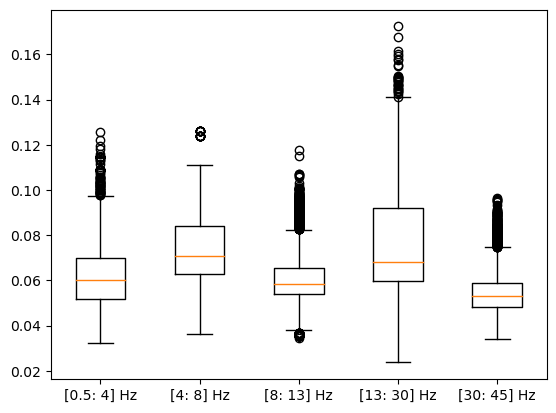

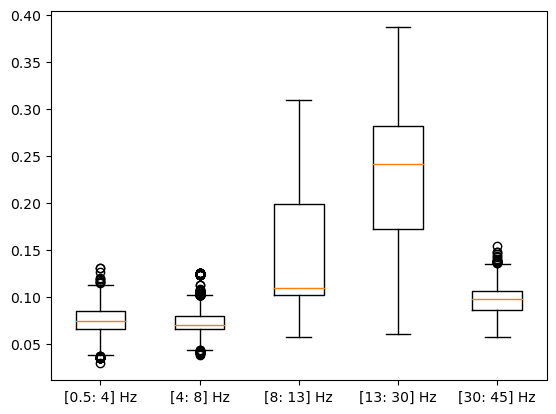

...

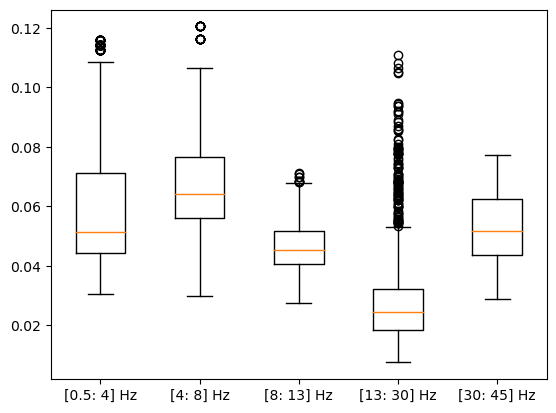

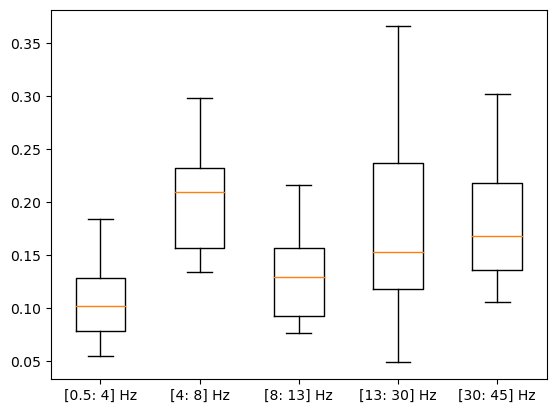

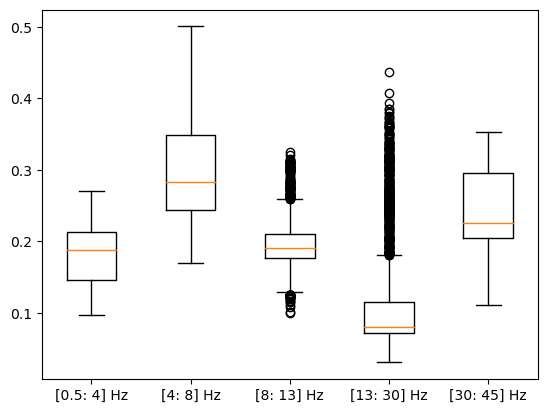

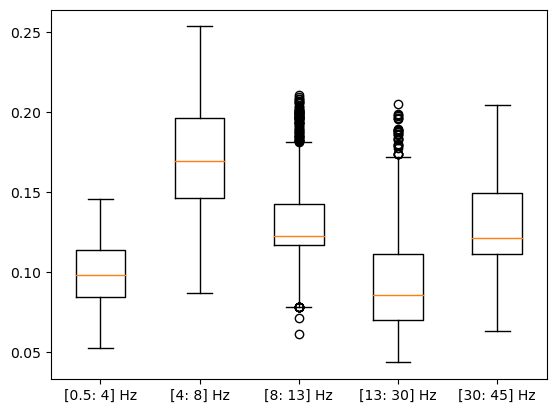

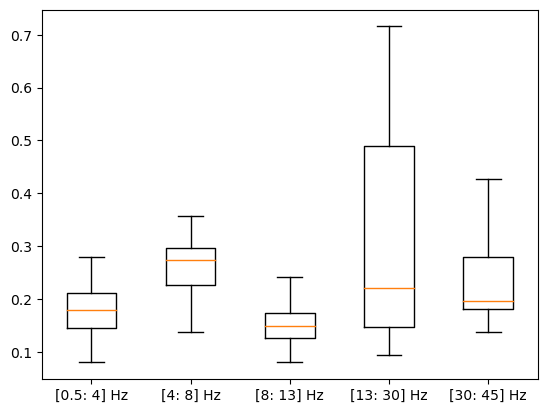

In [68]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

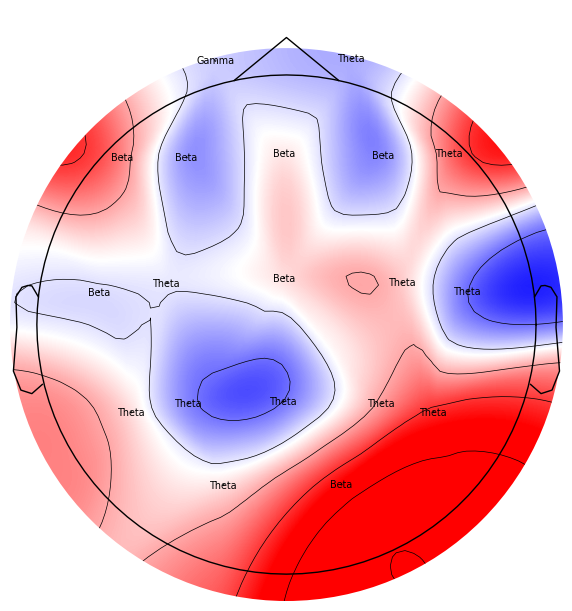

In [69]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [70]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

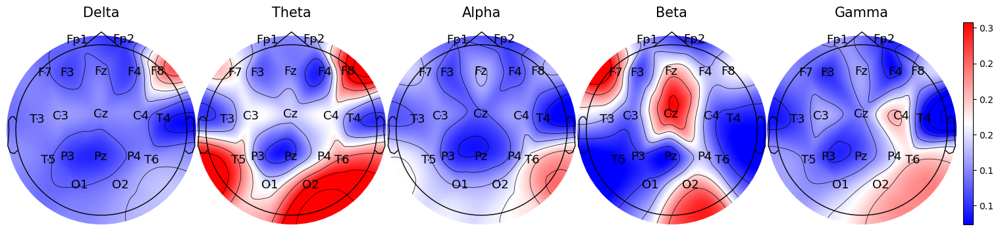

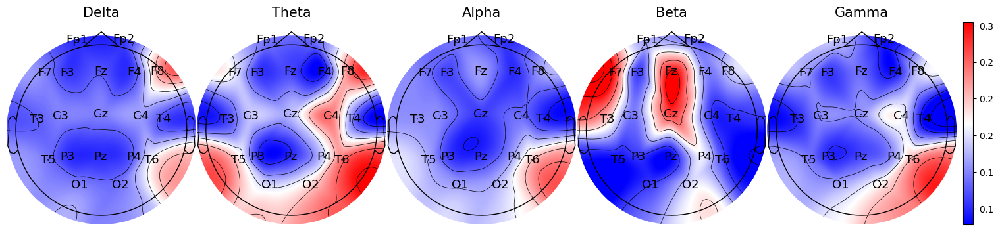

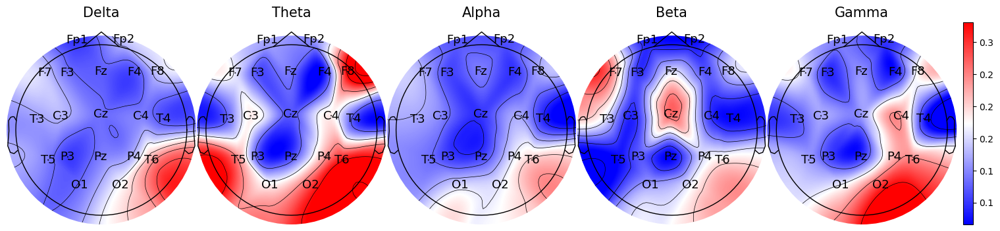

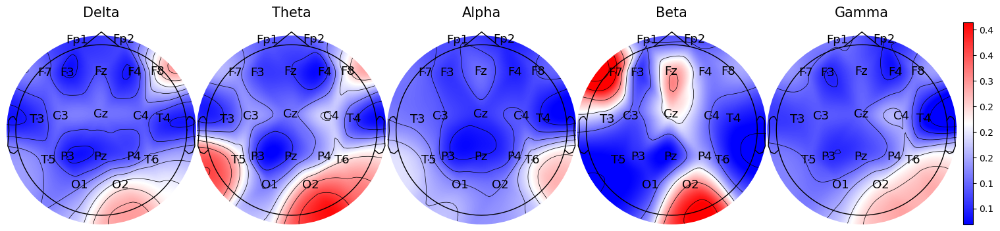

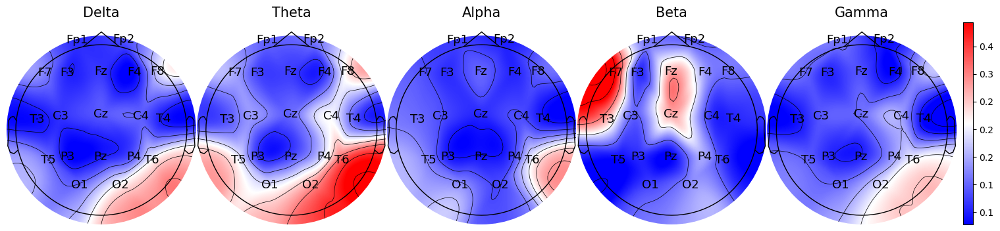

In [71]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="800_"+str(rand_idx))

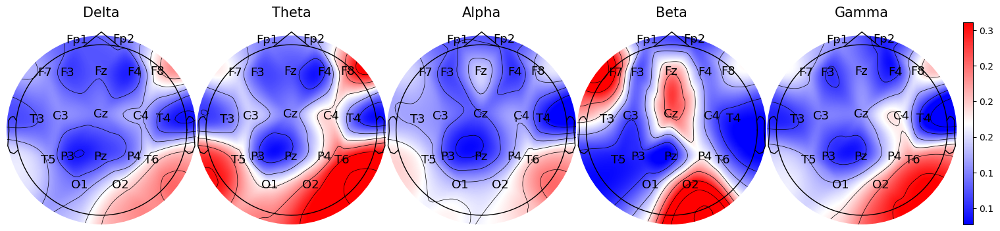

In [72]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="800_avg")

In [73]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 2614/2614 [00:17<00:00, 150.90it/s]


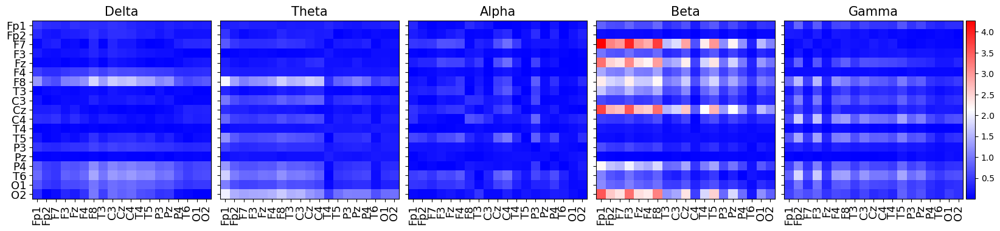

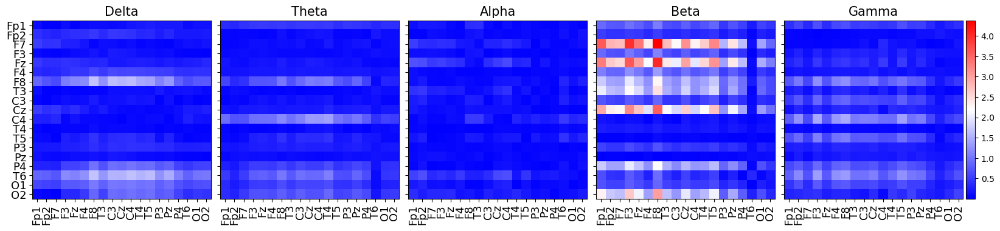

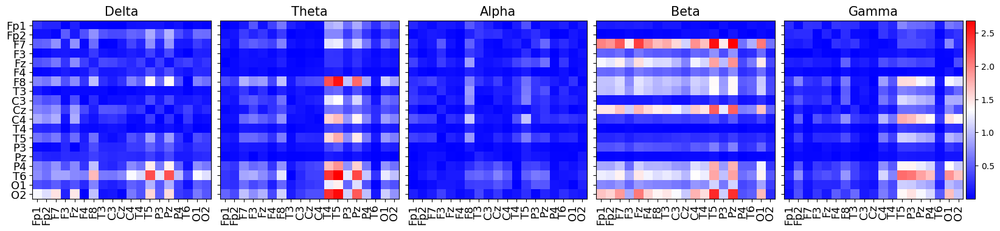

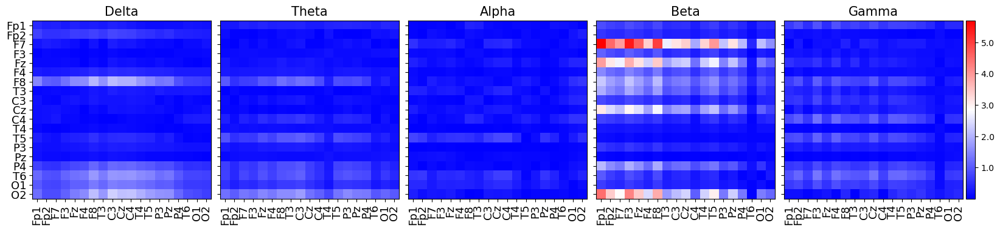

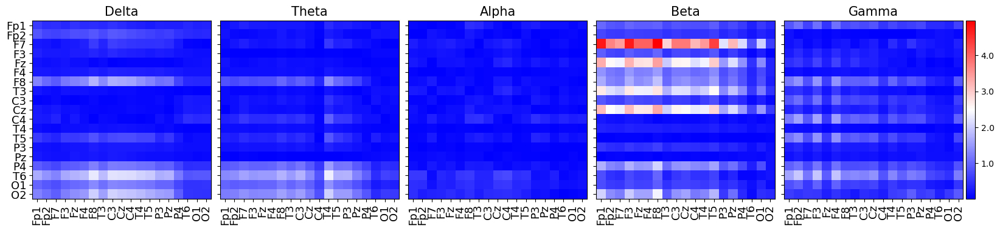

In [74]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="800_"+str(rand_idx))

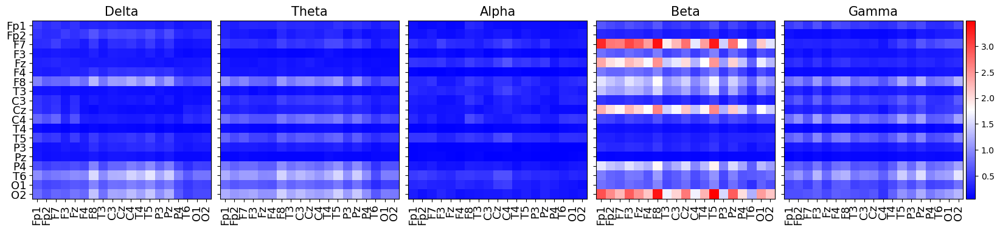

In [75]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="800_avg")

## Window size : 2000. Classification of Control vs MCI

In [76]:
train_X, train_graphs, train_y = build_data(train_data_files, size=2000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=2000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|████████████████████████████████████████| 693/693 [00:03<00:00, 176.65it/s]


In [77]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:05<00:00,  3.52it/s]


In [78]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9940417080436942
Precision:  [0.99162011 1.        ]
Recall:  [1.         0.97979798]
F1:  [0.99579243 0.98979592]
Confusion Matrix:  [[710   0]
 [  6 291]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[452   0]
 [  0 241]]


In [79]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 1007/1007 [00:06<00:00, 144.23it/s]


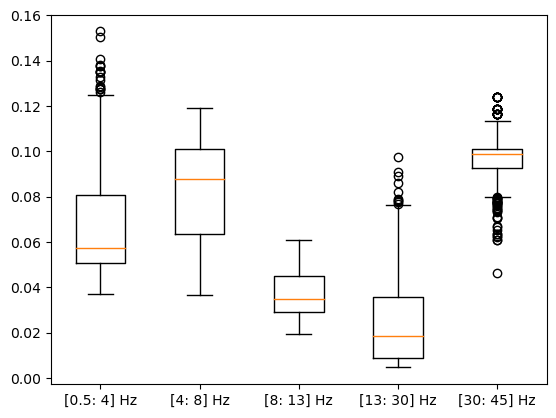

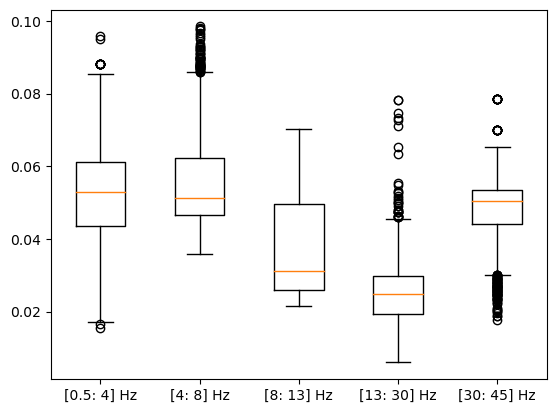

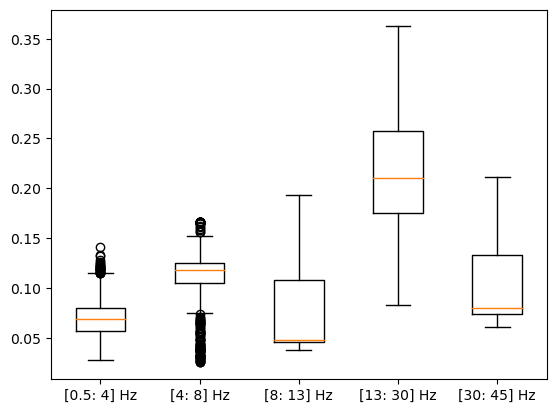

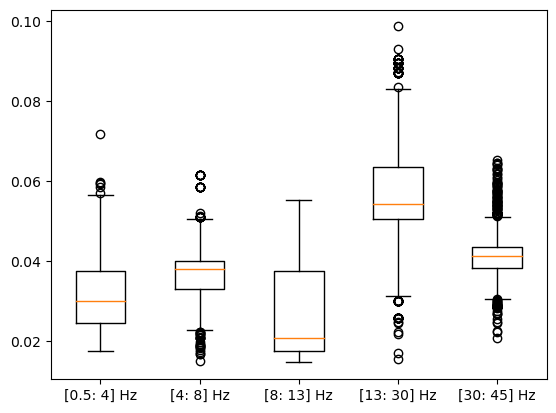

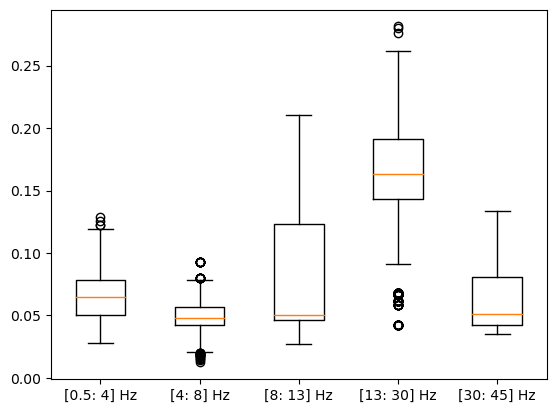

...

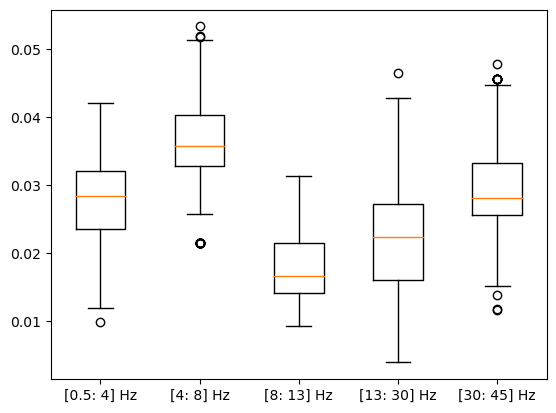

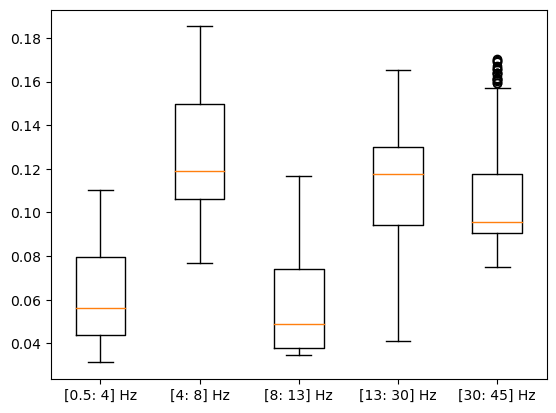

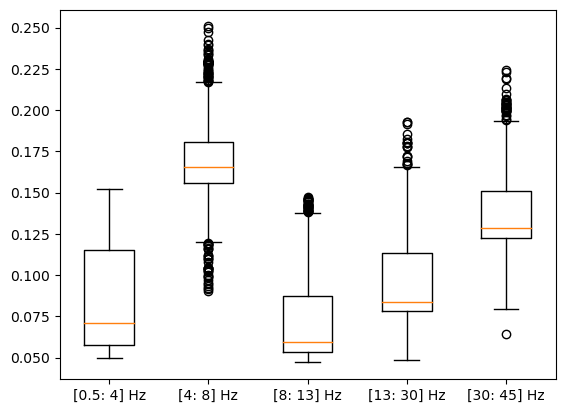

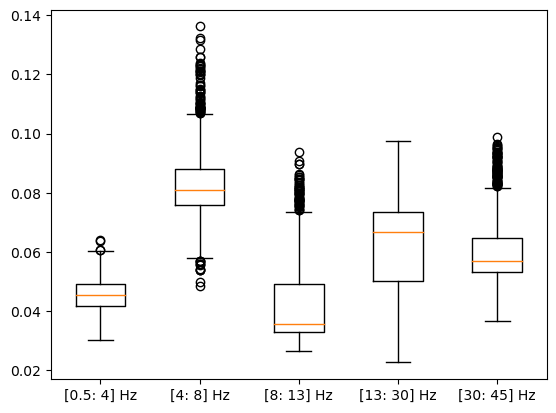

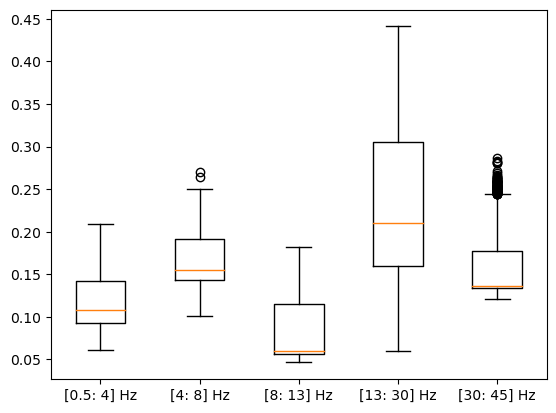

In [80]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)


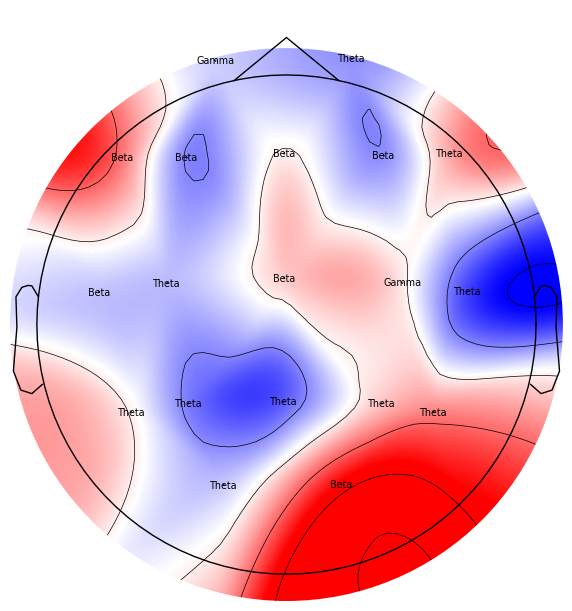

In [81]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [82]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

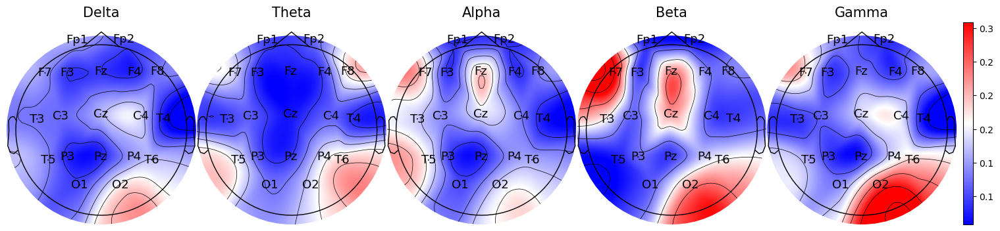

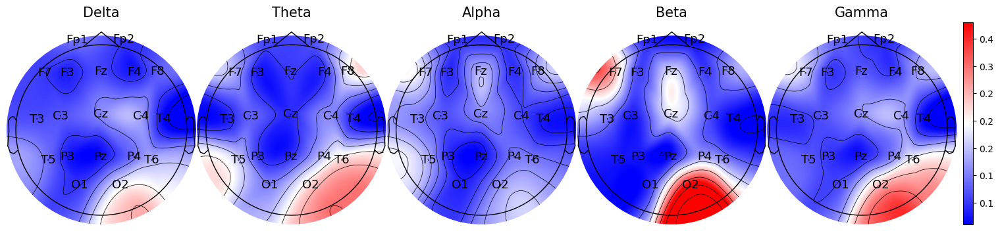

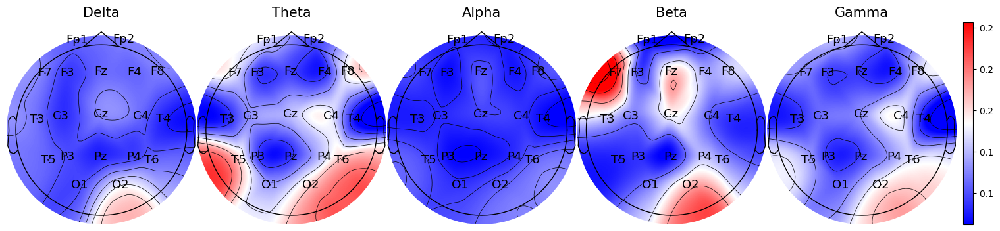

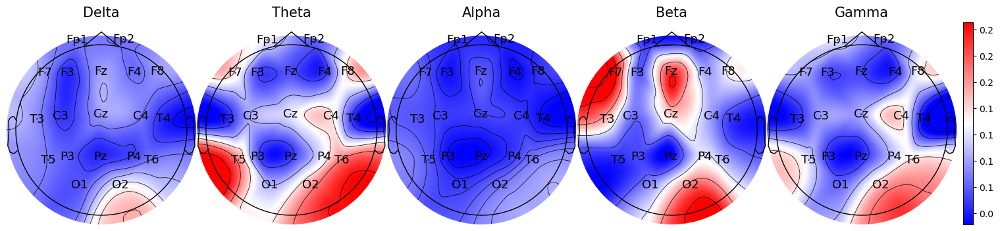

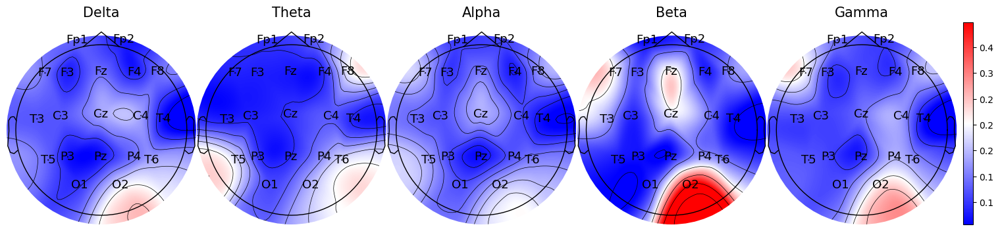

In [83]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="2000_"+str(rand_idx))

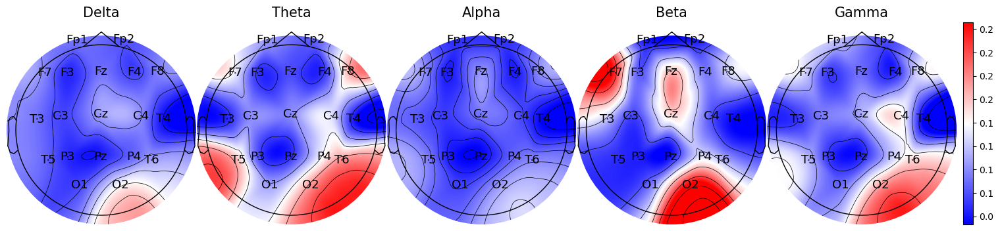

In [84]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="2000_avg")

In [85]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 1007/1007 [00:06<00:00, 144.14it/s]


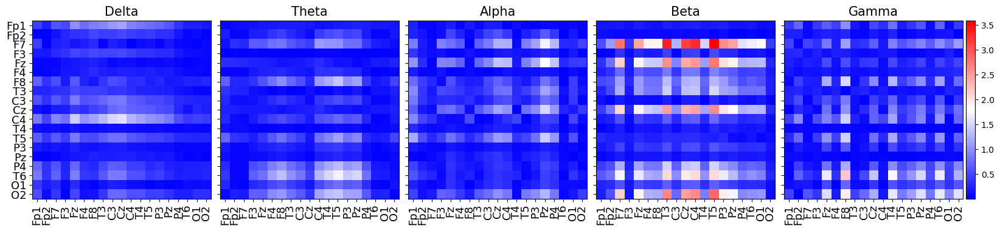

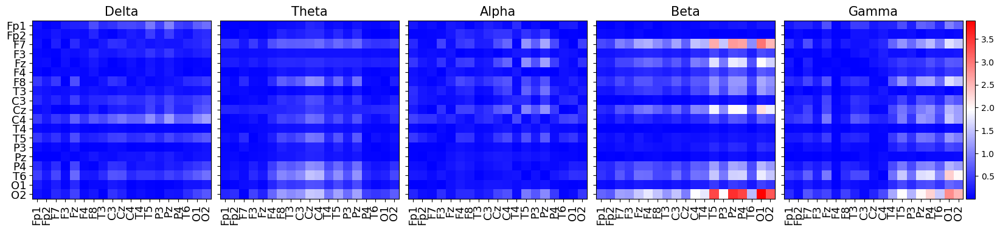

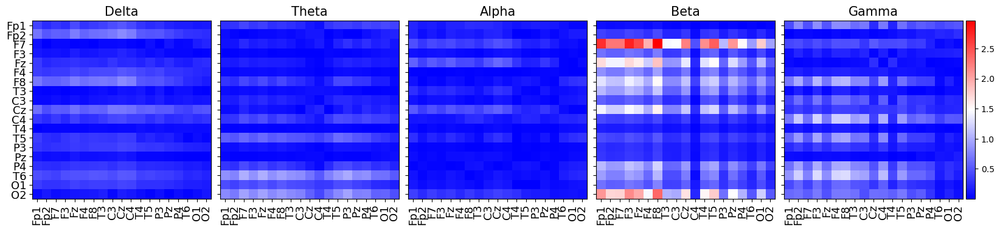

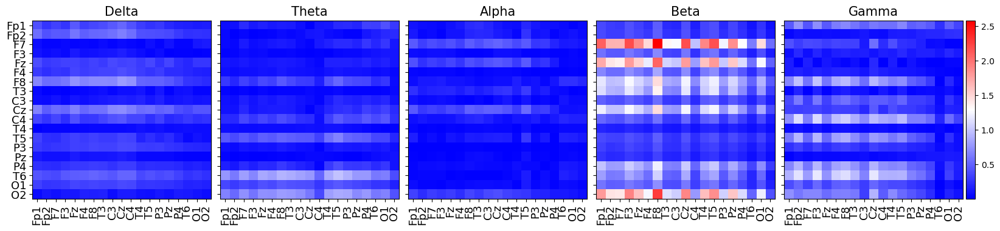

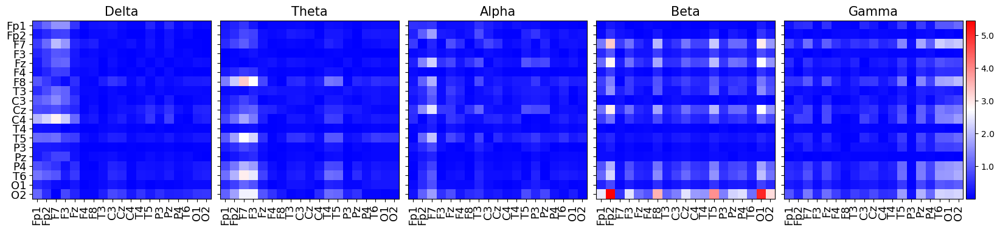

In [86]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="2000_"+str(rand_idx))

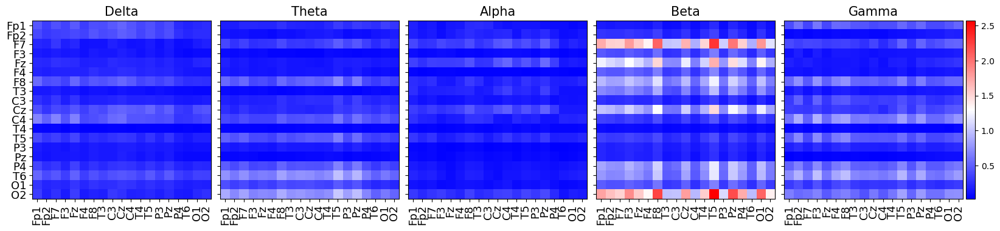

In [87]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="2000_avg")

## Window size : 3000. Classification of Control vs MCI

In [88]:
train_X, train_graphs, train_y = build_data(train_data_files, size=3000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=3000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|████████████████████████████████████████| 448/448 [00:02<00:00, 173.06it/s]


In [89]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:03<00:00,  5.09it/s]


In [90]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9861538461538462
Precision:  [0.98056156 1.        ]
Recall:  [1.         0.95408163]
F1:  [0.99018539 0.97650131]
Confusion Matrix:  [[454   0]
 [  9 187]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[288   0]
 [  0 160]]


In [91]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)
node_importances_avg = np.mean(node_importances, 2)

100%|████████████████████████████████████████| 650/650 [00:04<00:00, 151.08it/s]


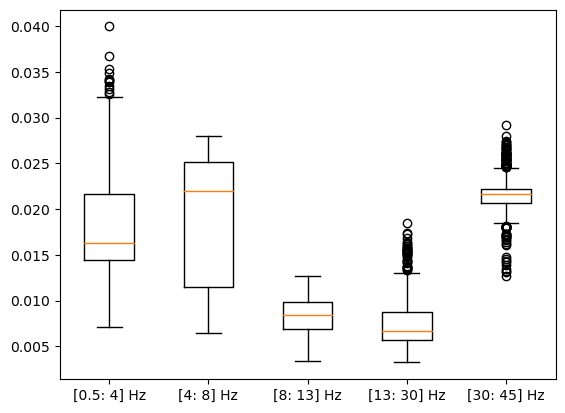

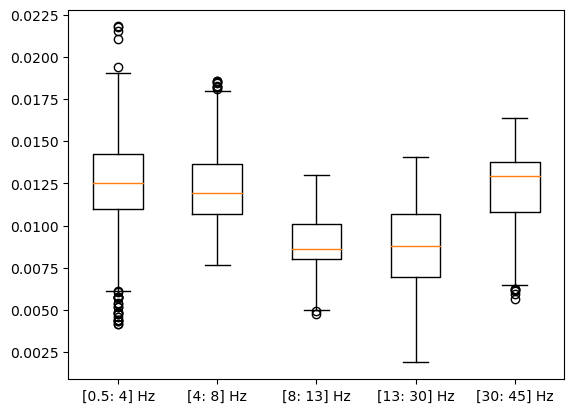

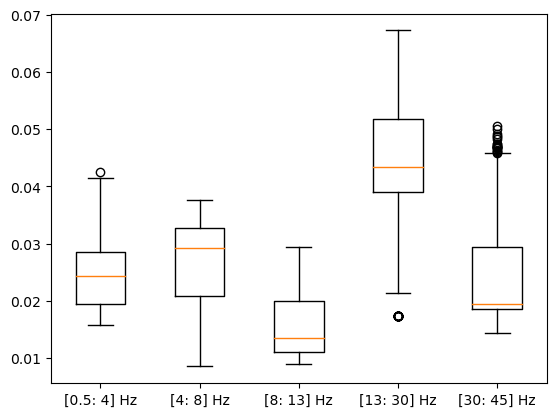

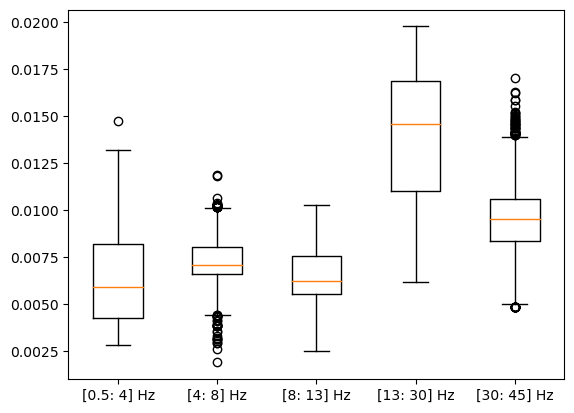

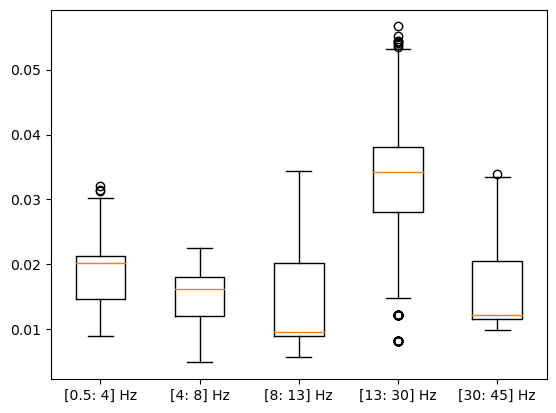

...

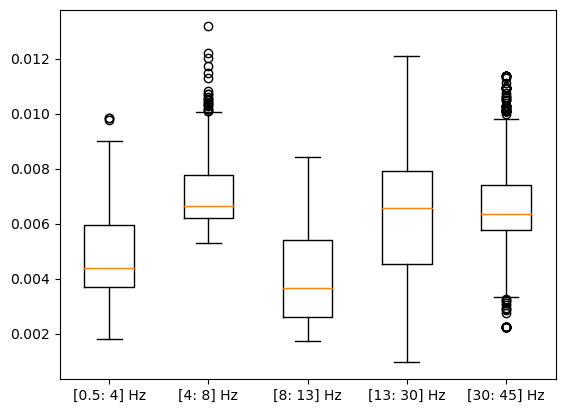

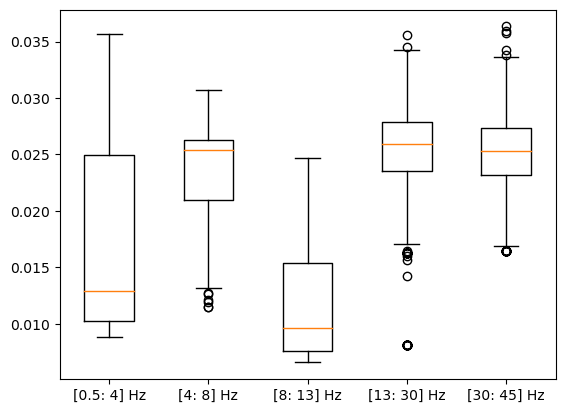

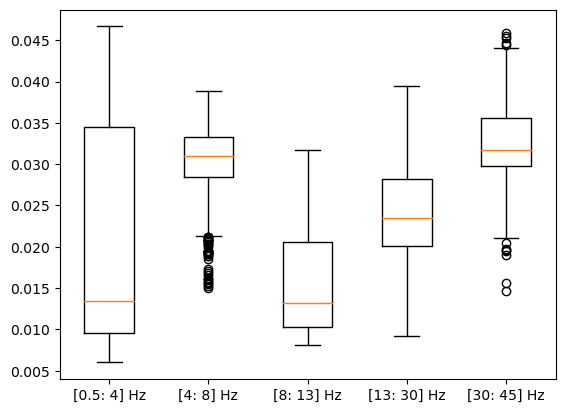

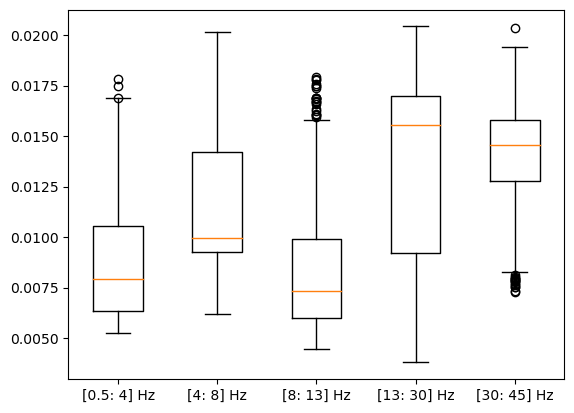

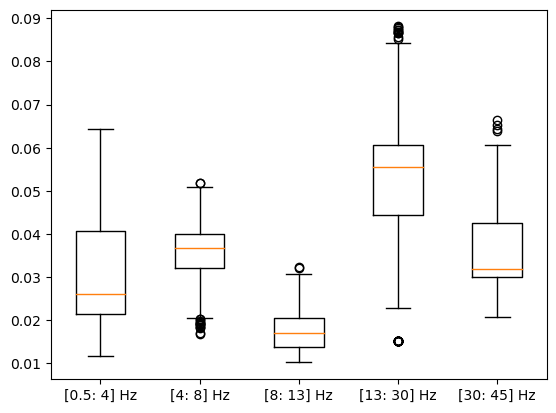

In [92]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

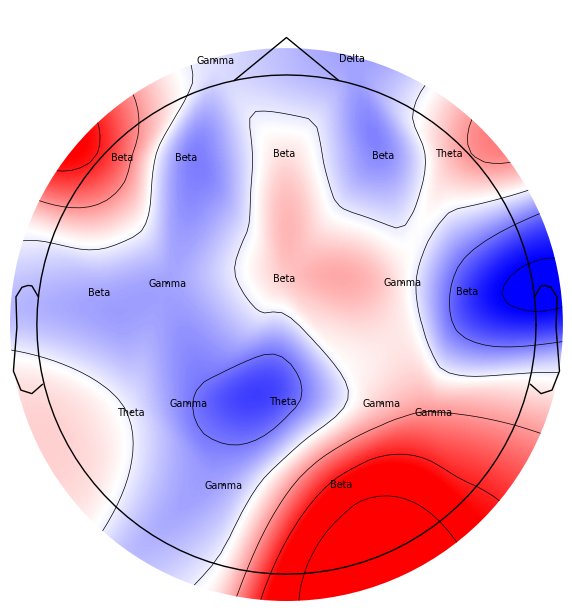

In [93]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [94]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

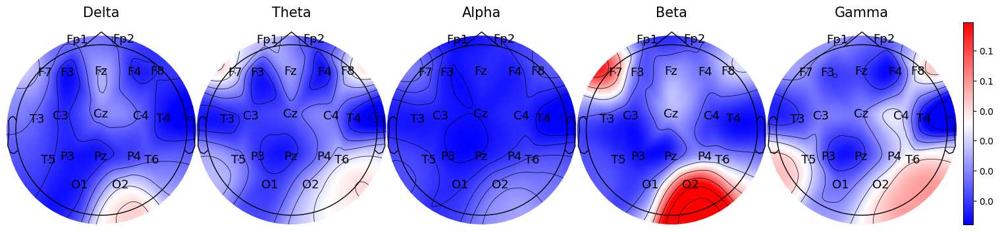

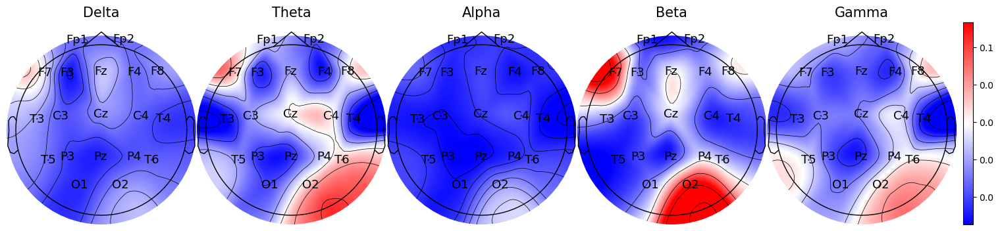

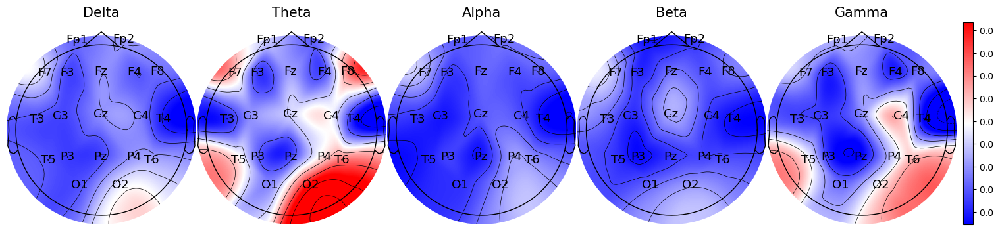

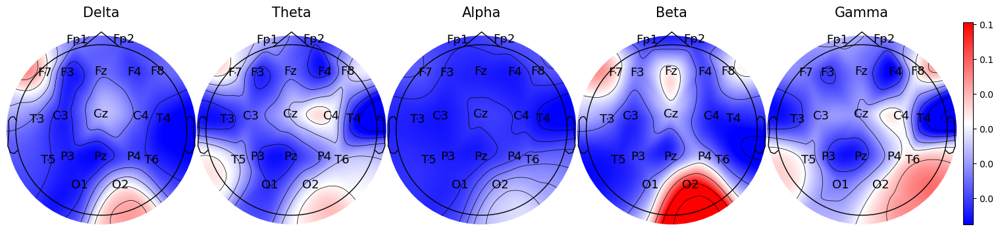

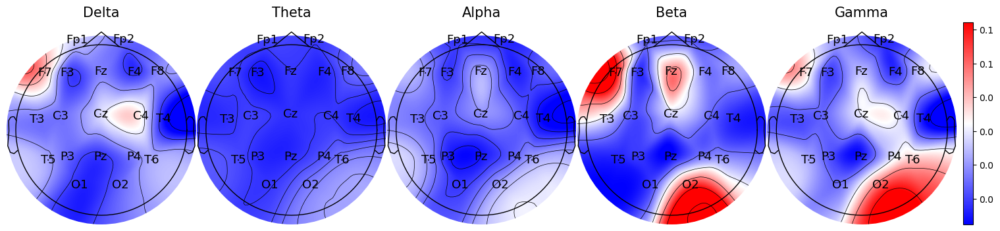

In [95]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="3000_"+str(rand_idx))

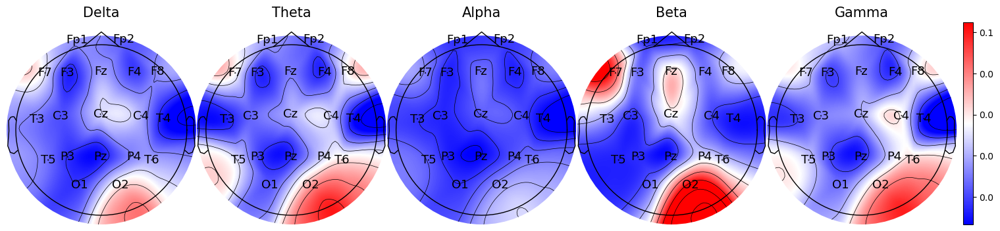

In [96]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="3000_avg")

In [97]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|████████████████████████████████████████| 650/650 [00:04<00:00, 147.05it/s]


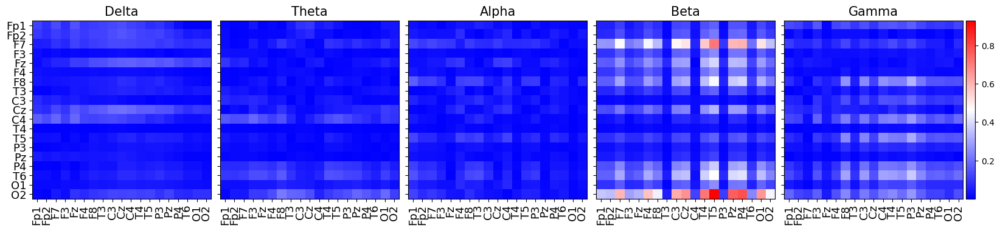

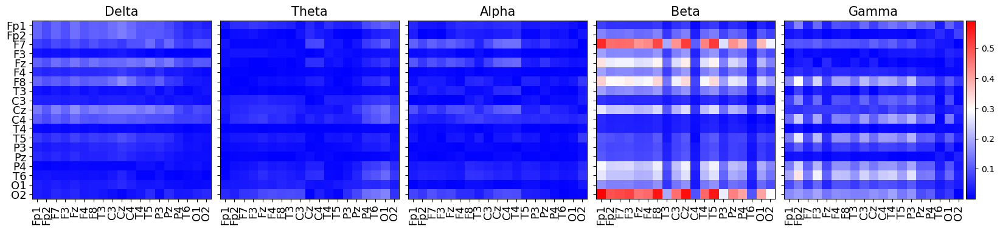

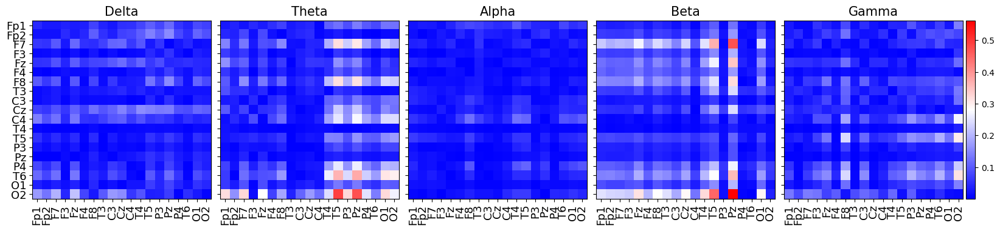

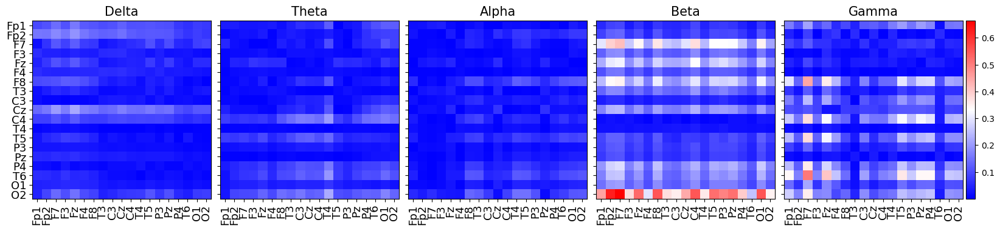

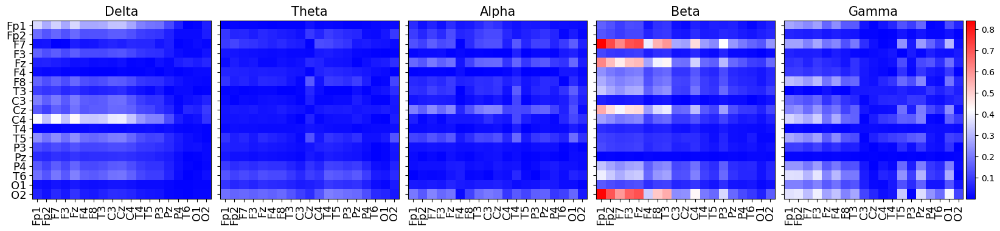

In [98]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="3000_"+str(rand_idx))

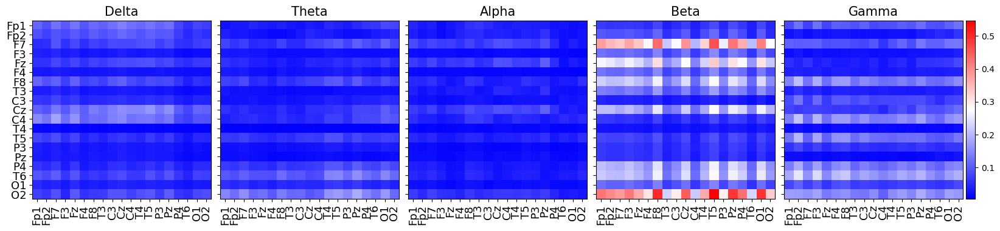

In [99]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="3000_avg")